# Assignment 1:  Superpixels and Image Segmentation.

Name: **Rishikesh Jadhav**

UID:  **119256534**

Link to Google Drive : **https://drive.google.com/file/d/1YQfYOJYQIMgG7Tt7RzRBNY631sTtmWne/view?usp=sharing**

**NOTE:** Please open the link in colab to view the notebook.

Please submit a PDF containing all outputs to gradescope by **October 5, 11:59pm**

----------------------------

In this assignment, you will learn about superpixels. You will first generate superpixels by clustering pixels via k-means. This will generate a superpixel map such as the following:

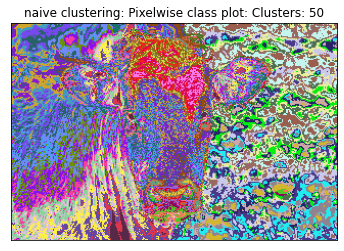

You will then implement a better superpixel algorithm: SLIC, which lets you generate superpixel maps like the following:

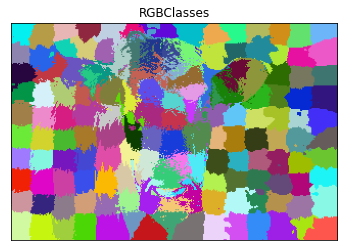

You will then build a segmentation network by training a deep neural network on your superpixels. This part is fairly open-ended, feel free to try any model you can think of (GNN, CNN, Transformer, etc.).

To give an example, for a CNN-based system that reformulates segmentation as superpixel image classification, there are basically three steps in the training stage:

1. Dilate and save each superpixel region from SLIC output into image of size 224X224, alongwith the ground truth segments label.
2. Build a couple of convolution layers to extract the deep features from each Superpixel patch image. Let the last layer be Fully connected layers.
3. Define the segmentation loss as multi-class classification loss and train a convolutional neural network based classifier.

Then, during inference, you would combine the classifier's predicted labels to form the whole input image's Superpixel segmentation results.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Part 1: Superpixels

For this first part of the assignment, you will implement 2 superpixels methods: k-means pixel clustering, and SLIC.

### Data

First, we download the MSRC labeled imaged database.

In [ ]:
import os


# Define the target directory in your Google Drive
target_directory = '/content/drive/My Drive/CMSC828I_HW1'

# Change the current working directory to the target directory
os.chdir(target_directory)

# Check the current working directory to verify the location
print(f"Current directory: {os.getcwd()}")

Current directory: /content/drive/My Drive/CMSC828I_HW1


In [ ]:
!wget http://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip
!unzip --qq msrc_objcategimagedatabase_v1.zip

--2023-10-02 17:05:45--  http://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip
Resolving download.microsoft.com (download.microsoft.com)... 23.36.245.101, 2a02:26f0:fe00:295::317f, 2a02:26f0:fe00:29e::317f
Connecting to download.microsoft.com (download.microsoft.com)|23.36.245.101|:80... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip [following]
--2023-10-02 17:05:45--  https://download.microsoft.com/download/A/1/1/A116CD80-5B79-407E-B5CE-3D5C6ED8B0D5/msrc_objcategimagedatabase_v1.zip
Connecting to download.microsoft.com (download.microsoft.com)|23.36.245.101|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 44119839 (42M) [application/octet-stream]
Saving to: ‘msrc_objcategimagedatabase_v1.zip’

msrc_objcategimaged 100%[===================>]  42.08M 

For the first part of this assignment, we will only use the following images. We define the list below as `im_list`.

In [ ]:
im_list = ['MSRC_ObjCategImageDatabase_v1/1_22_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/1_27_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/3_3_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/3_6_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/6_5_s.bmp',
           'MSRC_ObjCategImageDatabase_v1/7_19_s.bmp']

import cv2
im = cv2.imread(im_list[0])
image_shape = im.shape

print(f"Image shape: {image_shape}")

Image shape: (213, 320, 3)


We provide the following functions as helpers for plotting your results. Please pay attention to their signatures and outputs.





In [ ]:
#All important functions to plot
%matplotlib inline
import cv2
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as mpatches

def plot_image(im, title, xticks = [], yticks = [], isCv2 = True):
    """
    im :Image to plot
    title : Title of image
    xticks : List of tick values. Defaults to nothing
    yticks :List of tick values. Defaults to nothing
    cv2 :Is the image cv2 image? cv2 images are BGR instead of RGB. Default True
    """
    plt.figure()
    if isCv2:
        im = im[:,:,::-1]
    plt.imshow(im)
    plt.title(title)
    plt.xticks(xticks)
    plt.yticks(yticks)

def superpixel_plot(im,seg,title = "Superpixels"):
    """
    Given an image (nXmX3) and pixelwise class mat (nXm),
    1. Consider each class as a superpixel
    2. Calculate mean superpixel value for each class
    3. Replace the RGB value of each pixel in a class with the mean value

    Inputs:
    im: Input image
    seg: Segmentation map
    title: Title of the plot

    Output: None
    Creates a plot
    """
    clust = np.unique(seg)
    mapper_dict = {i: im[seg == i].mean(axis = 0)/255. for i in clust}

    seg_img =  np.zeros((seg.shape[0],seg.shape[1],3))
    for i in clust:
        seg_img[seg == i] = mapper_dict[i]

    plot_image(seg_img,title)

    return

def rgb_segment(seg,n = None,plot = True,title=None,legend = True,color = None):
    """
    Given a segmentation map, get the plot of the classes
    """
    clust = np.unique(seg)
    if n is None:
        n = len(clust)
    if color is None:
        cm = plt.cm.get_cmap('hsv',n+1)
        # mapper_dict = {i:np.array(cm(i/n)) for i in clust}
        mapper_dict = {i:np.random.rand(3,) for i in clust}
    #elif color == 'mean':
        #TODO..get the mean color of cluster center and assign that to mapper_dict

    seg_img =  np.zeros((seg.shape[0],seg.shape[1],3))
    for i in clust:
        seg_img[seg == i] = mapper_dict[i][:3]

    if plot:
        plot_image(seg_img,title = title)
    if legend:
        # get the colors of the values, according to the
        # colormap used by imshow
        patches = [ mpatches.Patch(color=mapper_dict[i], label=" : {l}".format(l=i) ) for i in range(n) ]
        # put those patched as legend-handles into the legend
        plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
        plt.grid(True)
        plt.show()

    return seg_img

For example, the following code uses `plot_image` to plot the 6 images we are using for this assignment.

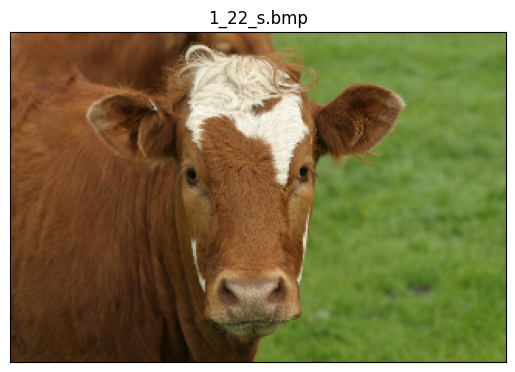

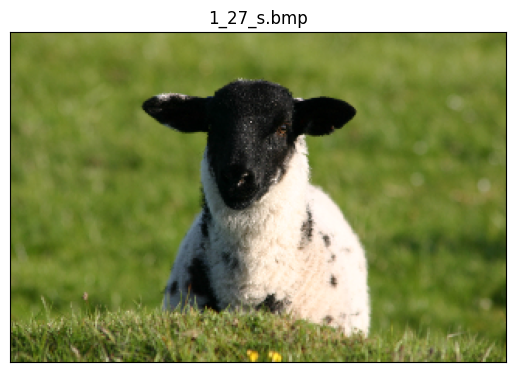

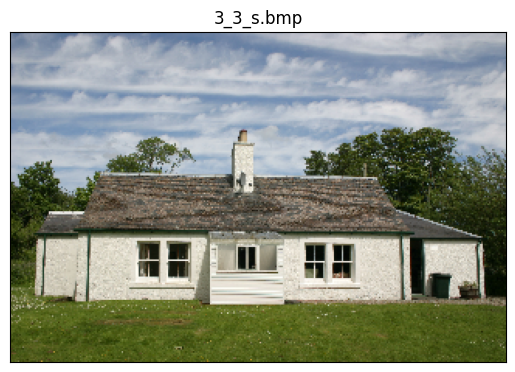

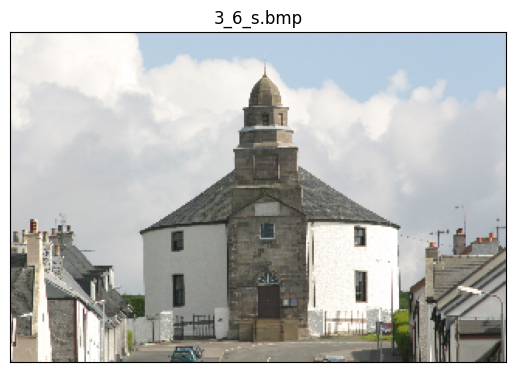

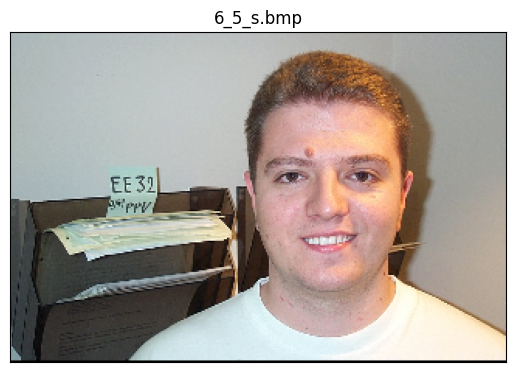

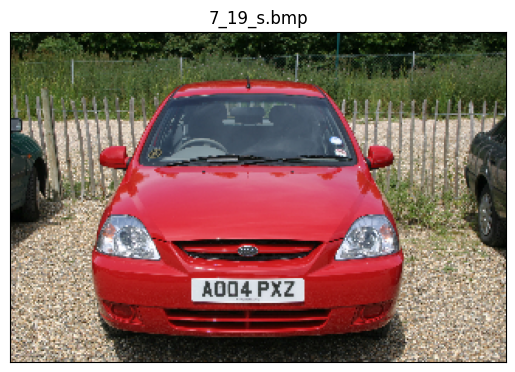

In [ ]:
for i in im_list:
    plot_image(cv2.imread(i),i.split("/")[-1])

### Question 1: Perform k-means on image pixels `(r, g, b, x, y)`. (40 points)

The k-means clustering algorithm is an unsupervised algorithm which, for some items and for some specified number of clusters represented by cluster centers, minimizes the distance between items and their associated cluster centers. It does so by iteratively assigning items to a cluster and recomputing the cluster center based on the assigned items.

Complete the pixel clustering function. It should take input an image (shape = `(n, m, 3)`) and number of clusters. Each pixel should be represented by a vector with 3 values: `(r, g, b, x, y)`.

Then, let our provided code plot the pixelwise and superpixel plots for the cow image (`1_22_s.bmp`), using your `cluster_pixels` implementation with the provided values for the number of clusters: `5, 10, 25, 50, 150`.




/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-65-f18edad7b664>:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-65-f18edad7b664>:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` ins

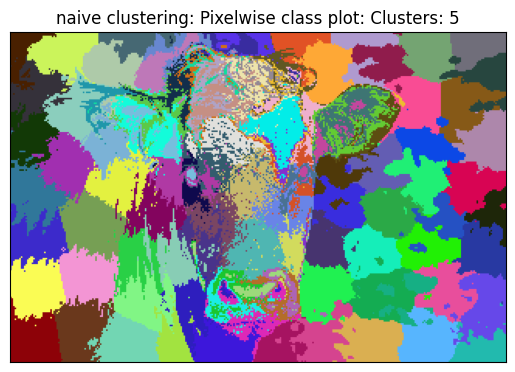

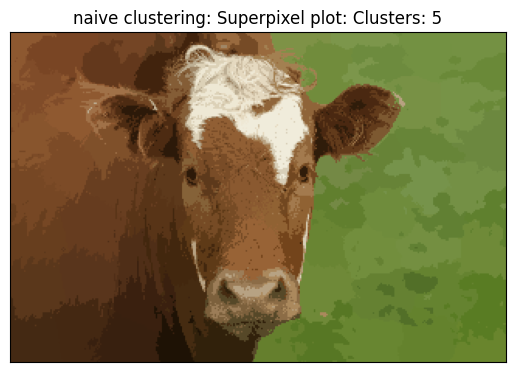

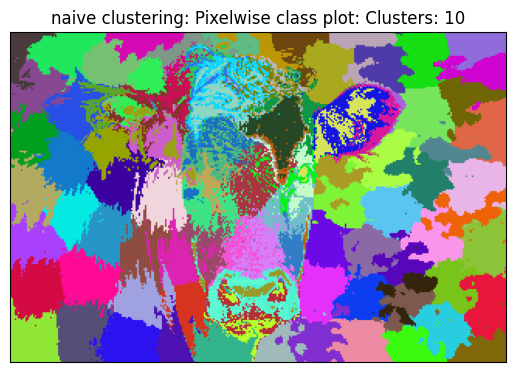

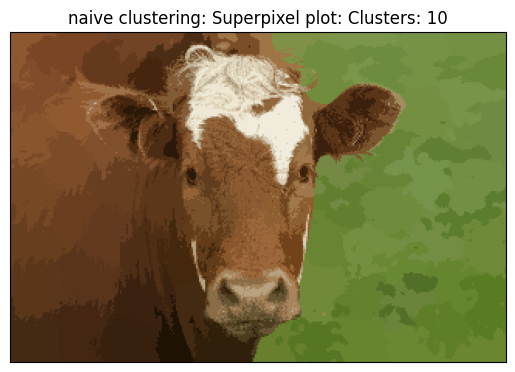

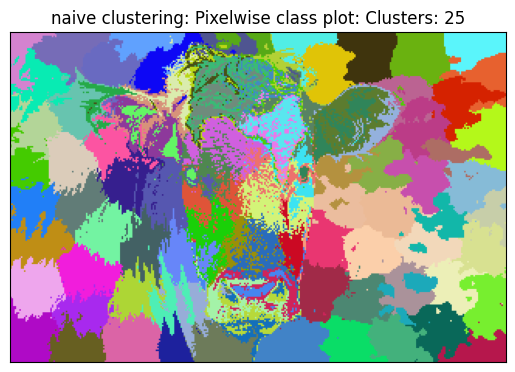

...

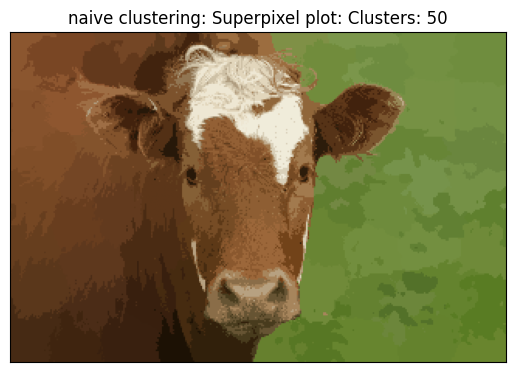

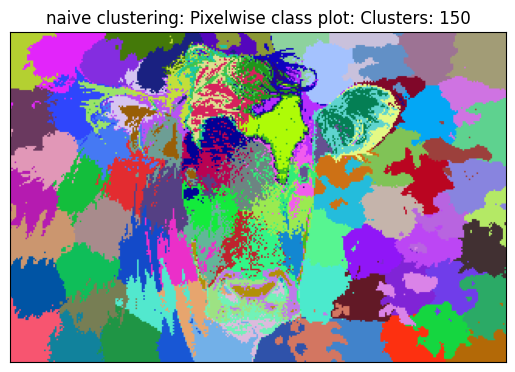

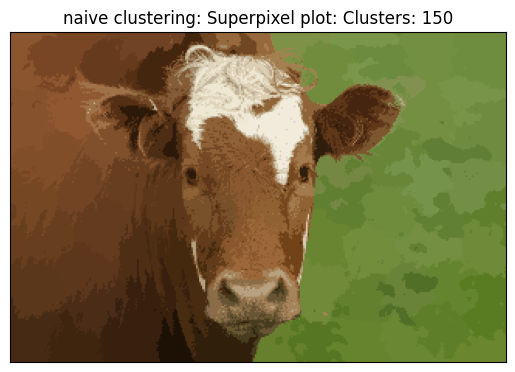

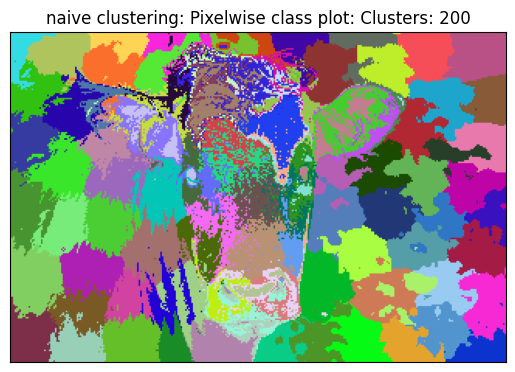

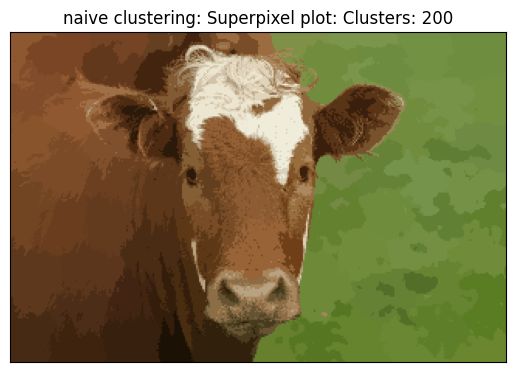

In [ ]:
from sklearn.cluster import KMeans
import numpy as  np

import numpy as np
from sklearn.cluster import KMeans

def cluster_rgbxy(image, num_clusters):
    """
    Given an input image and the desired number of clusters, return a 2D array
    segmap[0,0] represents the cluster of the pixel at image[0,0,:]
    """
    # Get the height , width the input image
    height, width, _ = image.shape
    # Create a 2D array to store feature vectors for each pixel (R, G, B, X, Y)
    feature_vectors = np.ones((height * width, 5), dtype=np.float32)
    # Iterate through each pixel's coordinates and assign the feature vector
    for y in range(height):
        for x in range(width):
            feature_vectors[y * width + x] = [image[y, x, 0], image[y, x, 1], image[y, x, 2], x, y]

    num_clusters = 100
    # Apply K-means clustering to the feature vectors
    kmeans = KMeans(n_clusters=num_clusters).fit(feature_vectors)

    # Get the cluster assignments for each pixel
    cluster_assignments = kmeans.labels_
    # Reshape the cluster assignments to create the segmentation map 'segmentation_map'
    segmentation_map = cluster_assignments.reshape(height, width)

    return segmentation_map


im = cv2.imread(im_list[0])
for k in [5, 10, 25, 50, 150, 200]:
    clusters = cluster_rgbxy(im, k)
    # Ensure that 'clusters' (segmap) has the same dimensions as 'im'
    assert clusters.shape == (im.shape[0], im.shape[1])
    _ = rgb_segment(clusters, n=k, title="naive clustering: Pixelwise class plot: Clusters: " + str(k), legend=False)
    superpixel_plot(im, clusters, title="naive clustering: Superpixel plot: Clusters: " + str(k))


Pick your favorite superpixel **k** value and plot results for all 6 images in `im_list`.

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-65-f18edad7b664>:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
<ipython-input-65-f18edad7b664>:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` ins

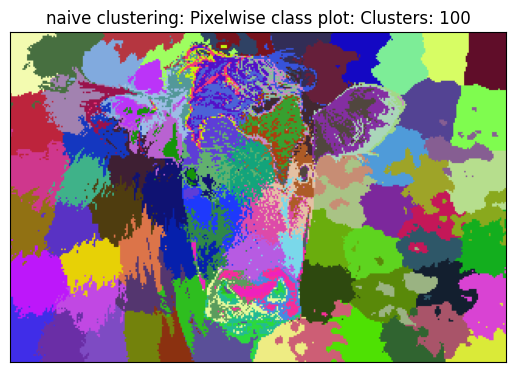

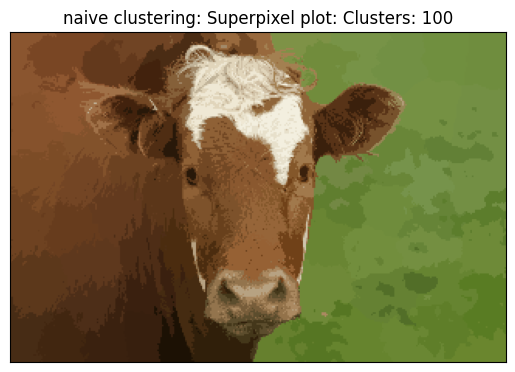

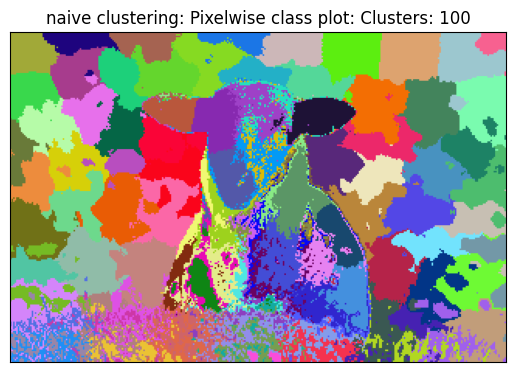

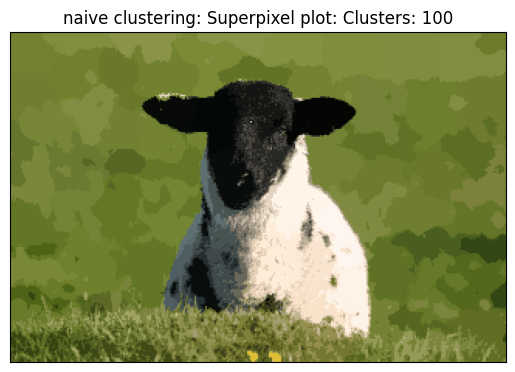

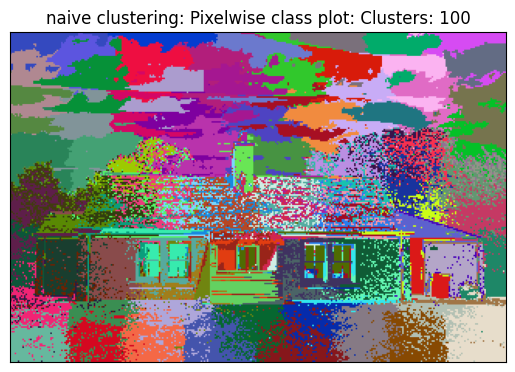

...

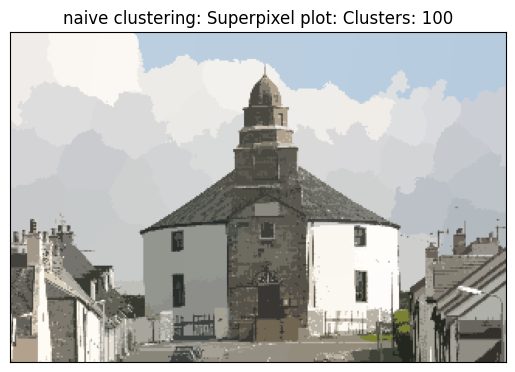

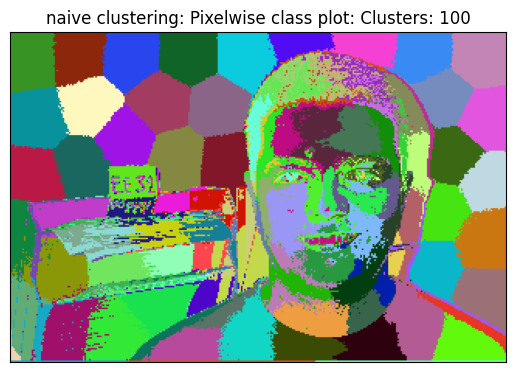

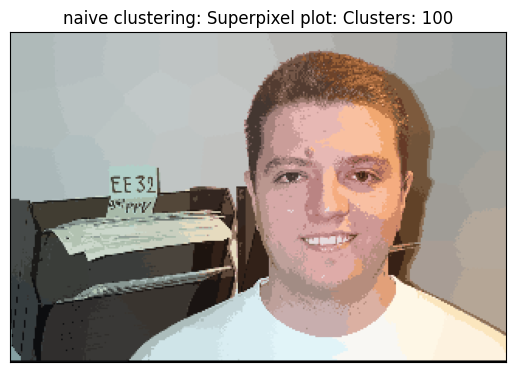

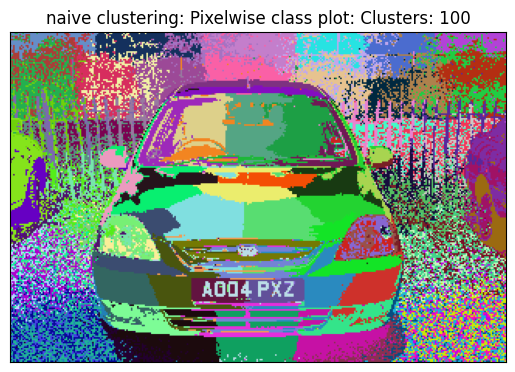

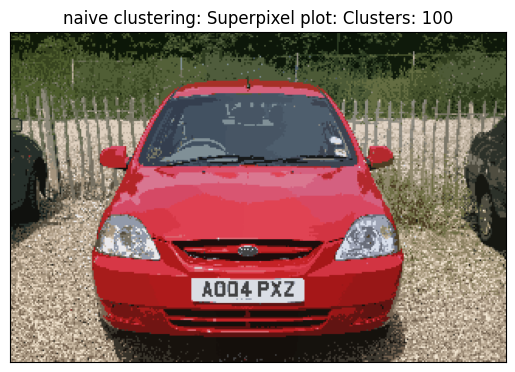

In [ ]:
# TODO: plot for 6 images with chosen k value
k =100
for image in im_list:
  im = cv2.imread(image)
  clusters = cluster_rgbxy(im,k)
  # Ensure that 'clusters' (segmap) has the same dimensions as 'im'
  assert clusters.shape == (im.shape[0], im.shape[1])
  _ = rgb_segment(clusters,n = k, title =  "naive clustering: Pixelwise class plot: Clusters: " + str(k),legend = False)
  superpixel_plot(im,clusters,title =  "naive clustering: Superpixel plot: Clusters: "+ str(k))


### Question 2: Replicate SLIC and Show Results for 6 Images (50 points)

It doesn't look like we have a very favourable outcome with superpixels being implemented with simple clustering. Can we do better? Have a look at the SLIC paper [here](https://www.iro.umontreal.ca/~mignotte/IFT6150/Articles/SLIC_Superpixels.pdf). Incorporate S and m and redefine your distance metric as per the paper.

**Finding an existing implementation of SLIC and using it for your assigment would be considered cheating.**

In [ ]:
import numpy as np
import cv2

In [ ]:
############Algorithm############
#Compute grid steps: S
#you can explore different values of m
#initialize cluster centers [l,a,b,x,y] using
#Perturb for minimum G
#while not converged
##for every pixel:
####  compare distance D_s with each cluster center within 2S X 2S.
####  Assign to nearest cluster
##calculate new cluster center

def initialize_cluster_centers(image, s):
    # Initialize an empty array to store cluster centers
    cluster_centers = np.array([])
    # Get height and width of the input image
    height_image, width_image = image.shape[:2]
    # Initialize current height and width
    curr_height = int(s // 2)
    curr_width = int(s // 2)

    # Set Flag to check if any clusters are found
    flag = 0
    while curr_height < height_image:
        while curr_width < width_image:
            if len(cluster_centers) == 0:
                cluster_centers = np.array([curr_height, curr_width, image[curr_height, curr_width, 0], image[curr_height, curr_width, 1], image[curr_height, curr_width, 2]])
            else:
                flag = 1
                cluster_centers = np.vstack((cluster_centers, np.array([curr_height, curr_width, image[curr_height, curr_width, 0], image[curr_height, curr_width, 1], image[curr_height, curr_width, 2]])))
            # Move to next column
            curr_width += s
            curr_width = int(curr_width)

            # Break if 'k' clusters are found
            if len(cluster_centers) == k and flag == 1:
                break

        # Reset the current width and move to the next row
        curr_width = s // 2
        curr_width = int(curr_width)
        curr_height += s
        curr_height = int(curr_height)

        # Break if 'k' clusters are found
        if len(cluster_centers) == k and flag == 1:
            break

    return cluster_centers

def optimize_superpixel_centers(cluster_centers, image):

    for i in range(len(cluster_centers)):
        # Get coordinates of the current cluster center
        center_x = int(cluster_centers[i, 0])
        center_y = int(cluster_centers[i, 1])
        # Check that the cluster center is within bounds
        center_x = max(1, min(center_x, image.shape[0] - 2))
        center_y = max(1, min(center_y, image.shape[1] - 2))

        # Calculate gradient for current cluster center
        curr_gradient = (
            int(image[center_x + 1, center_y + 1, 0]) - int(image[center_x, center_y, 0]) +
            int(image[center_x + 1, center_y + 1, 1]) - int(image[center_x, center_y, 1]) +
            int(image[center_x + 1, center_y + 1, 2]) - int(image[center_x, center_y, 2])
        )

        for dh in range(-1, 2):
            for dw in range(-1, 2):

                # Calculate coordinates of a potential new cluster center
                new_center_x = int(center_x + dh)
                new_center_y = int(center_y + dw)
                # Check that the new cluster center is within bounds
                new_center_x = max(1, min(new_center_x, image.shape[0] - 2))
                new_center_y = max(1, min(new_center_y, image.shape[1] - 2))

                # Calculate gradient for the potential new cluster center
                new_gradient = (
                    int(image[new_center_x + 1, new_center_y + 1, 0]) - int(image[new_center_x, new_center_y, 0]) +
                    int(image[new_center_x + 1, new_center_y + 1, 1]) - int(image[new_center_x, new_center_y, 1]) +
                    int(image[new_center_x + 1, new_center_y + 1, 2]) - int(image[new_center_x, new_center_y, 2])
                )

                # Update the cluster center if the new gradient is smaller
                if new_gradient < curr_gradient:
                    curr_gradient = new_gradient
                    cluster_centers[i, 0] = new_center_x
                    cluster_centers[i, 1] = new_center_y
                    cluster_centers[i, 2] = image[new_center_x, new_center_y, 0]
                    cluster_centers[i, 3] = image[new_center_x, new_center_y, 1]
                    cluster_centers[i, 4] = image[new_center_x, new_center_y, 2]

    return cluster_centers

def assign_pixels_to_clusters(image, cluster_centers, s, m):

    height, width, _ = image.shape
    num_iterations = 100

    # Initialize variables to store pixel distances, cluster labels, and new cluster centers
    pixel_distances = np.ones((height, width)) * 1e12
    cluster_labels = np.ones((height, width)) * -1
    new_cluster_centers = np.zeros((len(cluster_centers), 3))

    # Iteratively assign pixels to clusters and optimize cluster centers
    for _ in range(num_iterations):
        for j in range(len(cluster_centers)):
            for h in range(int(cluster_centers[j, 0] - s), int(cluster_centers[j, 0] + s)):
                if 0 <= h < height:
                    for w in range(int(cluster_centers[j, 1] - s), int(cluster_centers[j, 1] + s)):
                        if 0 <= w < width:
                            # Calculate color and spatial distances
                            color_distance = np.sqrt(
                                (int(image[h, w, 0]) - cluster_centers[j, 2]) ** 2 +
                                (int(image[h, w, 1]) - cluster_centers[j, 3]) ** 2 +
                                (int(image[h, w, 2]) - cluster_centers[j, 4]) ** 2
                            )
                            spatial_distance = np.sqrt((h - cluster_centers[j, 0]) ** 2 + (w - cluster_centers[j, 1]) ** 2)
                            distance = color_distance + (m / s) * spatial_distance

                            # Update cluster assignment if the distance is smaller
                            if distance < pixel_distances[h, w]:
                                pixel_distances[h, w] = distance
                                if cluster_labels[h, w] != -1:
                                    new_cluster_centers[int(cluster_labels[h, w]), 0] -= h
                                    new_cluster_centers[int(cluster_labels[h, w]), 1] -= w
                                    new_cluster_centers[int(cluster_labels[h, w]), 2] -= 1
                                cluster_labels[h, w] = j
                                new_cluster_centers[j, 0] += h
                                new_cluster_centers[j, 1] += w
                                new_cluster_centers[j, 2] += 1

        # Update cluster centers
        for j in range(len(cluster_centers)):
            cluster_centers[j, 0] = int(new_cluster_centers[j, 0] // new_cluster_centers[j, 2])
            cluster_centers[j, 1] = int(new_cluster_centers[j, 1] // new_cluster_centers[j, 2])
            cluster_centers[j, 2] = image[int(cluster_centers[j, 0]), int(cluster_centers[j, 1]), 0]
            cluster_centers[j, 3] = image[int(cluster_centers[j, 0]), int(cluster_centers[j, 1]), 1]
            cluster_centers[j, 4] = image[int(cluster_centers[j, 0]), int(cluster_centers[j, 1]), 2]

    return cluster_labels


def slic_segmap(im, k, s, m=10):

    # Step 1: Initialize cluster centers for superpixels
    kcentroids = initialize_cluster_centers(im, s)

    # Step 2: Optimize superpixel cluster centers
    kcentroids = optimize_superpixel_centers(kcentroids, im)

    # Step 3: Assign pixels to superpixel clusters
    cluster_labels = assign_pixels_to_clusters(im, kcentroids, s, m)

    return cluster_labels

def SLIC(im, k):
    """
    Input arguments:
    im: image input
    k: number of cluster segments


    Compute
    S: As described in the paper
    m: As described in the paper (use the same value as in the paper)
    follow the algorithm..

    returns:
    segmap: 2D matrix where each value corresponds to the image pixel's cluster number
    """
    # Calculate initial grid size 's' based on desired number of clusters 'k'
    s = np.sqrt((im.shape[0] * im.shape[1]) / k)
    # Convert the input image to LAB color space
    image = cv2.cvtColor(im, cv2.COLOR_BGR2LAB)
    # Perform SLIC to obtain the cluster labels
    segmap = slic_segmap(image, k, s)
    segmap = segmap.reshape(im.shape[0], im.shape[1])

    return segmap


With SLIC implemented, plot results for all 6 images.

<ipython-input-4-f18edad7b664>:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)


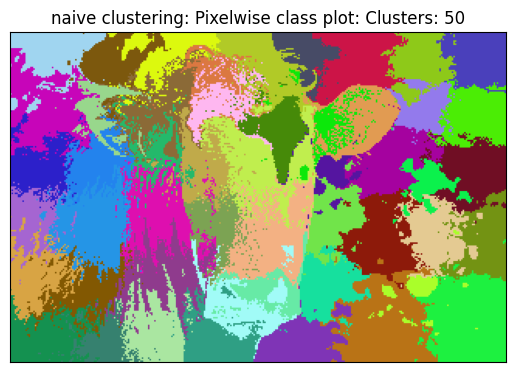

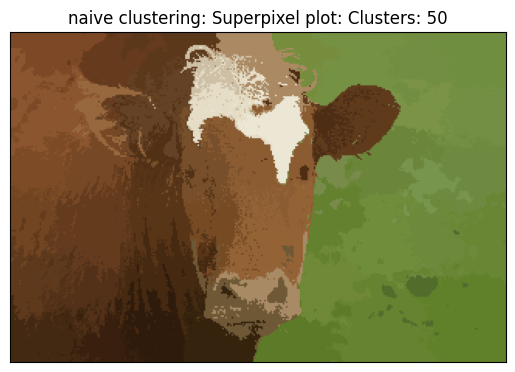

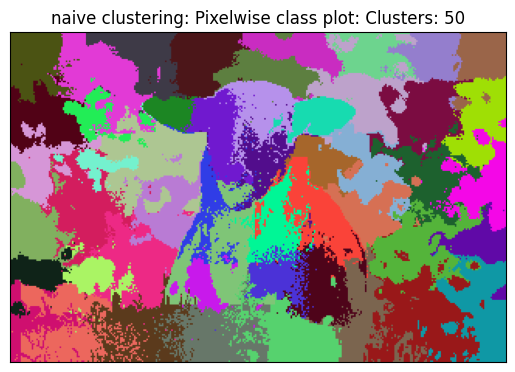

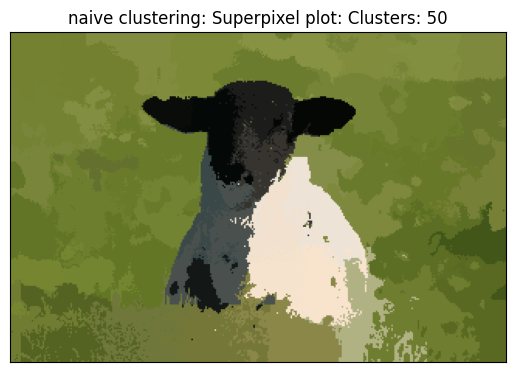

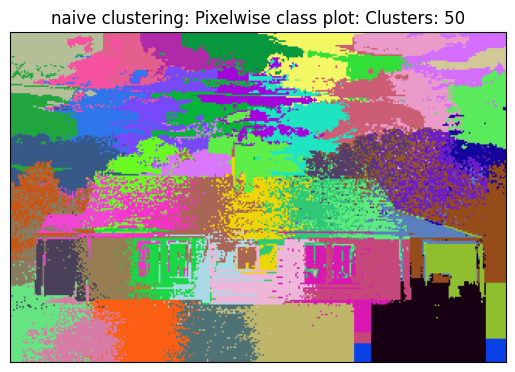

...

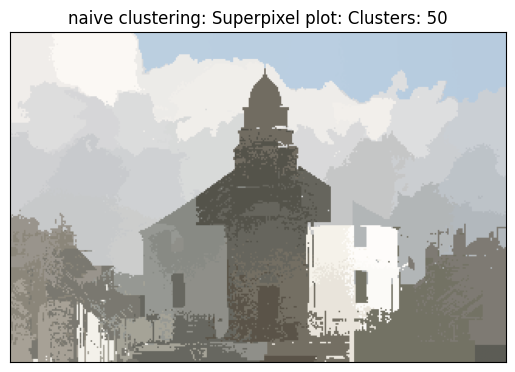

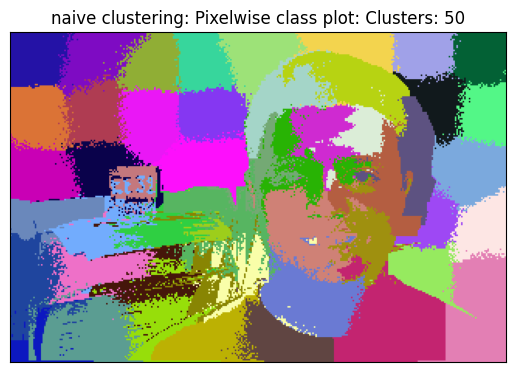

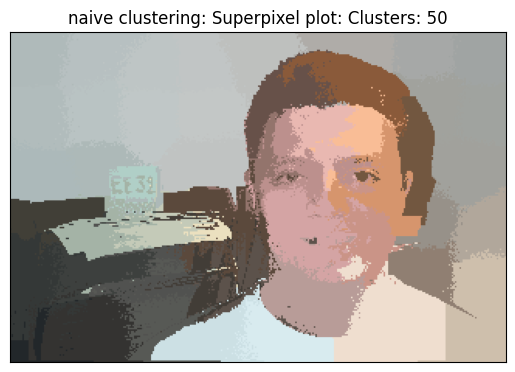

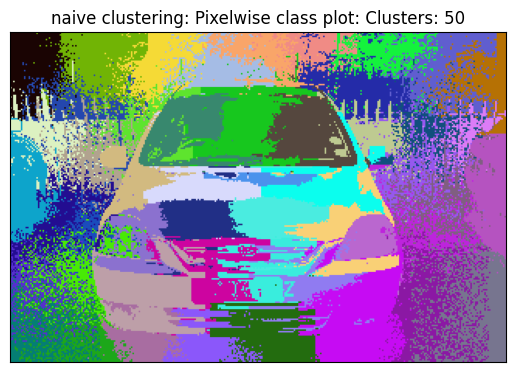

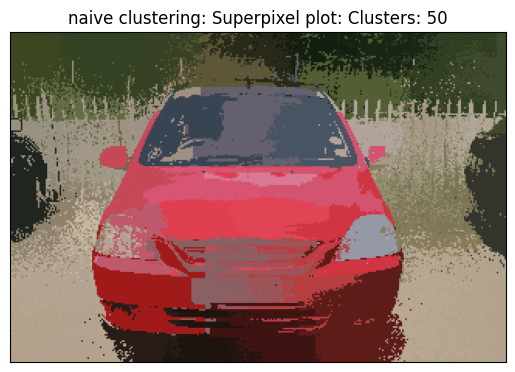

In [ ]:
## TODO: Call our plot functions with your SLIC results for all 6 images

for i in im_list:
    im = cv2.imread(i)
    for k in [50]:
        clusters = SLIC(im, k)
        _ = rgb_segment(clusters, n=k, title="naive clustering: Pixelwise class plot: Clusters: " + str(k), legend=False)
        superpixel_plot(im, clusters, title="naive clustering: Superpixel plot: Clusters: " + str(k))

### Question 3: What advantage did the SLIC give compared to `(r, g, b, x, y)`? Please answer in 3 sentences or fewer. (10 points)

Your Answer:

**Compactness and Uniformity:** SLIC generates superpixels that are more compact and uniform in size and shape, reducing over-segmentation problem associated with pixel-wise representations. This leads to more meaningful regions in an image.

**Efficiency:** SLIC is computationally efficient and can quickly segment images into superpixels, making it suitable for real-time applications. It leverages both color and spatial information, providing a good trade-off between accuracy and speed.

**Reduced Noise Sensitivity:** SLIC is less sensitive to noise and small variations in pixel values compared to pixel-based representations. This results in more stable and consistent superpixel boundaries making

### Bonus Question 4: Enforce connectivity (20 points, OPTIONAL)
There are many superpixels which are very small and disconnected from each other. Merge them with larger superpixels

O(N) algorithm:
1. Set minimum size of superpixel
2. If region smaller than threshold, assign to nearest cluster

Plot results for the 6 images.


(213, 320, 3)


<ipython-input-4-f18edad7b664>:58: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('hsv',n+1)


(213, 320, 3)
(213, 320, 3)
(213, 320, 3)
(213, 320, 3)
(213, 320, 3)


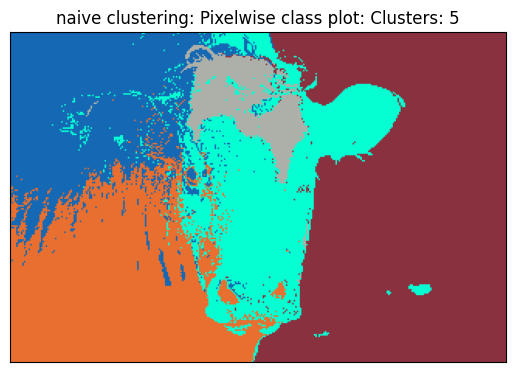

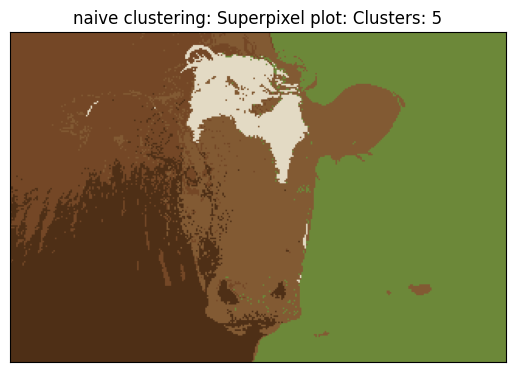

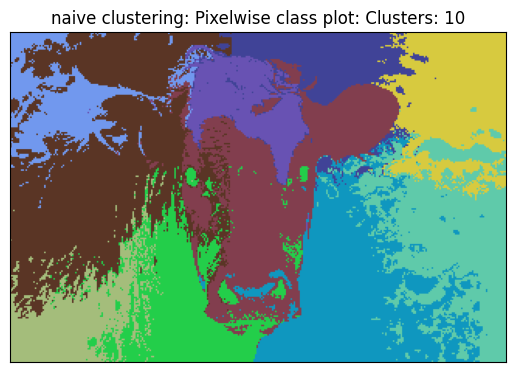

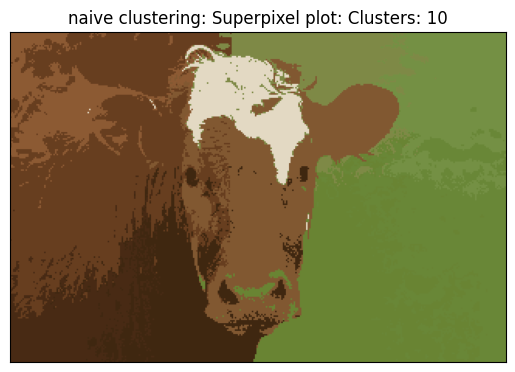

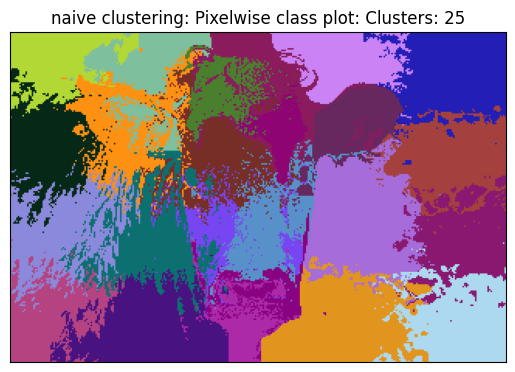

...

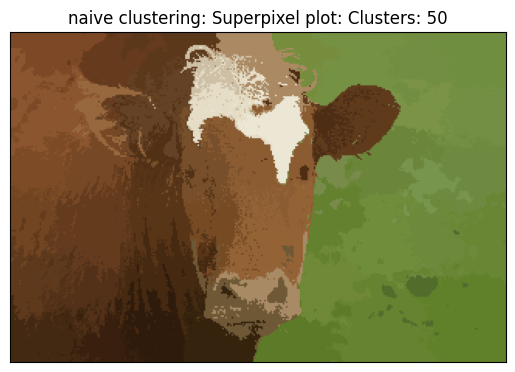

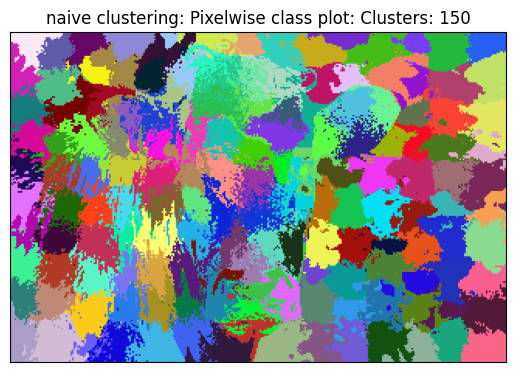

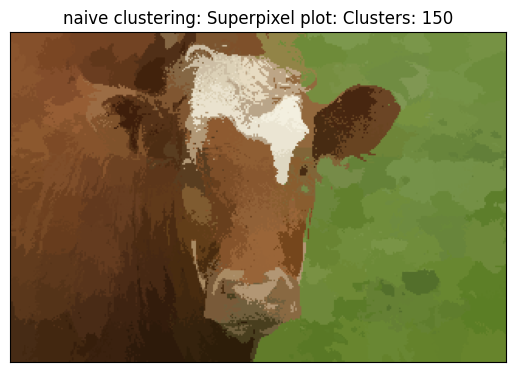

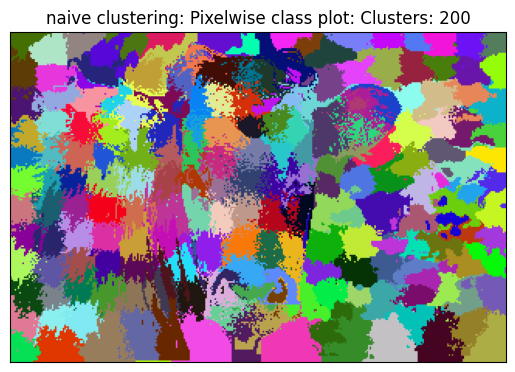

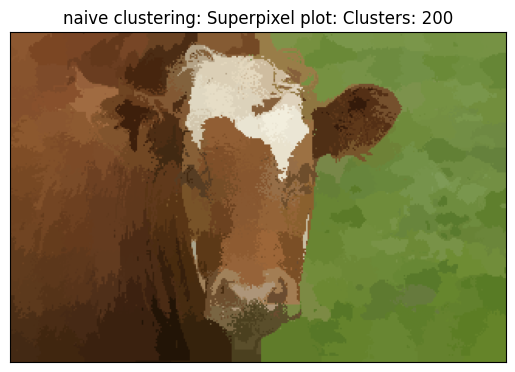

In [ ]:

def closest_large_superpixel_finder(segmap, current_label, label_pixels):
    height, width = segmap.shape
    min_distance = np.inf
    nearest_label = current_label

    for x, y in zip(label_pixels[1], label_pixels[0]):
        for i in range(max(y - 1, 0), min(y + 2, height)):
            for j in range(max(x - 1, 0), min(x + 2, width)):
                if segmap[i, j] != current_label:
                    dist = np.sqrt((x - j) ** 2 + (y - i) ** 2)
                    if dist < min_distance:
                        min_distance = dist
                        nearest_label = segmap[i, j]

    return nearest_label

def merge_small_clusters(seg_map, min_threshold):

    height, width = seg_map.shape
    unique_labels = np.unique(seg_map)

    for label in unique_labels:
        # Skip the background label (-1)
        if label == -1:
            continue

        label_pixels = np.where(seg_map == label)
        no_pixels = len(label_pixels[0])

        # Check if superpixel size is smaller than the threshold
        if no_pixels < min_threshold:
            nearest_label = closest_large_superpixel_finder(seg_map, label, label_pixels)

            # Merge the small superpixel with its nearest larger superpixel
            seg_map[label_pixels] = nearest_label

    return seg_map

im = cv2.imread(im_list[0])
for k in [5, 10, 25, 50, 150, 200]:
    print(im.shape)
    clusters = SLIC(im,k)
    new_segmap = merge_small_clusters(clusters, 5)
    _ = rgb_segment(new_segmap,n = k, title =  "naive clustering: Pixelwise class plot: Clusters: " + str(k),legend = False)
    superpixel_plot(im,new_segmap,title =  "naive clustering: Superpixel plot: Clusters: "+ str(k))

## Part 2: Segmentation

For this part, you will use your best superpixels to build an image segmentation system. Alternatively, you can use SLIC from some library, as we demonstrate in the Data section that follows.

### Data

This is mostly the same as the last part, except now we also need to consider the annotated ground truth segmentation maps.

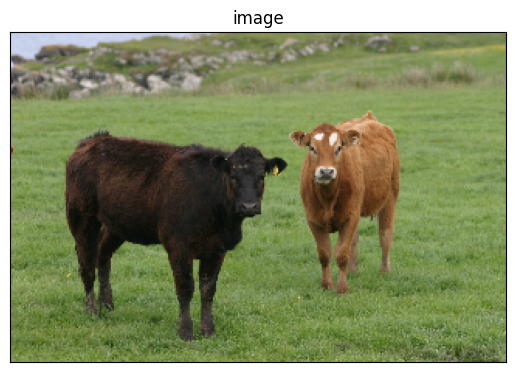

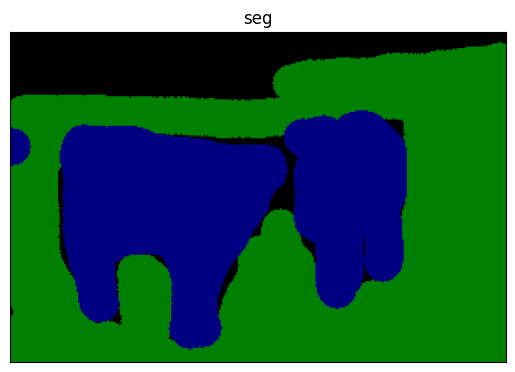

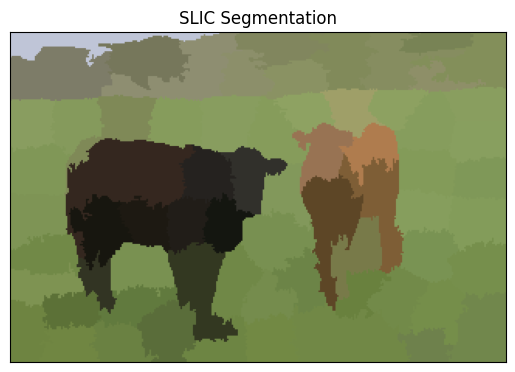

In [ ]:
#  plot a sample image and its ground truth segments
image_sample = cv2.imread('MSRC_ObjCategImageDatabase_v1/1_19_s.bmp')
seg_sample = cv2.imread('MSRC_ObjCategImageDatabase_v1/1_19_s_GT.bmp')
plot_image(image_sample, 'image')
plot_image(seg_sample, 'seg')

#  run SLIC on the sample image and plot the corresponding SLIC segments
from skimage.segmentation import slic

segments_sample = slic(image_sample, n_segments=100, compactness=10)
superpixel_plot(image_sample, segments_sample, title = "SLIC Segmentation")

In [ ]:
from IPython import embed
import os
current_directory = os.getcwd()
print(current_directory)
msrc_directory = current_directory + '/MSRC_ObjCategImageDatabase_v1'

#Superpixel dataset preparation

# from Dataset_v1
SEG_LABELS_LIST_v1 = [
    {"id": -1, "name": "void",       "rgb_values": [0,   0,    0]},
    {"id": 0,  "name": "building",   "rgb_values": [128, 0,    0]},
    {"id": 1,  "name": "grass",      "rgb_values": [0,   128,  0]},
    {"id": 2,  "name": "tree",       "rgb_values": [128, 128,  0]},
    {"id": 3,  "name": "cow",        "rgb_values": [0,   0,    128]},
    {"id": 4,  "name": "sky",        "rgb_values": [128, 128,  128]},
    {"id": 5,  "name": "airplane",   "rgb_values": [192, 0,    0]},
    {"id": 6, "name": "face",       "rgb_values": [192, 128,  0]},
    {"id": 7, "name": "car",        "rgb_values": [64,  0,    128]},
    {"id": 8, "name": "bicycle",    "rgb_values": [192, 0,    128]},
    {"id": -1, "name": "horse",       "rgb_values": [128,   0,    128]},
    {"id": -1, "name": "water",       "rgb_values": [64,   128,    0]},
    {"id": -1, "name": "mountain",       "rgb_values": [64,   0,    0]},
    {"id": -1, "name": "sheep",       "rgb_values": [0,   128,    128]}]

# from Dataset_v2
SEG_LABELS_LIST_v2 = [
    {"id": -1, "name": "void",       "rgb_values": [0,   0,    0]},
    {"id": 0,  "name": "building",   "rgb_values": [128, 0,    0]},
    {"id": 1,  "name": "grass",      "rgb_values": [0,   128,  0]},
    {"id": 2,  "name": "tree",       "rgb_values": [128, 128,  0]},
    {"id": 3,  "name": "cow",        "rgb_values": [0,   0,    128]},
    {"id": 4,  "name": "horse",      "rgb_values": [128, 0,    128]},
    {"id": 5,  "name": "sheep",      "rgb_values": [0,   128,  128]},
    {"id": 6,  "name": "sky",        "rgb_values": [128, 128,  128]},
    {"id": 7,  "name": "mountain",   "rgb_values": [64,  0,    0]},
    {"id": 8,  "name": "airplane",   "rgb_values": [192, 0,    0]},
    {"id": 9,  "name": "water",      "rgb_values": [64,  128,  0]},
    {"id": 10, "name": "face",       "rgb_values": [192, 128,  0]},
    {"id": 11, "name": "car",        "rgb_values": [64,  0,    128]},
    {"id": 12, "name": "bicycle",    "rgb_values": [192, 0,    128]},
    {"id": 13, "name": "flower",     "rgb_values": [64,  128,  128]},
    {"id": 14, "name": "sign",       "rgb_values": [192, 128,  128]},
    {"id": 15, "name": "bird",       "rgb_values": [0,   64,   0]},
    {"id": 16, "name": "book",       "rgb_values": [128, 64,   0]},
    {"id": 17, "name": "chair",      "rgb_values": [0,   192,  0]},
    {"id": 18, "name": "road",       "rgb_values": [128, 64,   128]},
    {"id": 19, "name": "cat",        "rgb_values": [0,   192,  128]},
    {"id": 20, "name": "dog",        "rgb_values": [128, 192,  128]},
    {"id": 21, "name": "body",       "rgb_values": [64,  64,   0]},
    {"id": 22, "name": "boat",       "rgb_values": [192, 64,   0]}]

# create a map rgb_2_label, where mapping the ground truth 3-d array segmentation into a single ID label.
rgb_2_label = {}
label_2_rgb = {}
for i in SEG_LABELS_LIST_v1:
    rgb_2_label[tuple(i['rgb_values'])] = i['id']
    label_2_rgb[i['id']] = i['rgb_values']

/content/drive/MyDrive/CMSC828I_HW1


### Question 5: Superpixel Dataset (30 points)

First, we dilate each superpixel and save the output superpixel patch from SLIC into 224X224 size image (after rescaling), alongwith the ground truth segments label.

For the purpose of consistency, we adopt the existing SLIC implementation from the scikit-learn machine learning package.

Suggested algorithm: Save the superpixels along with their segmentation class. You could implement this as follows:

For each image
1. Get superpixels sp_i for image x. We adopt 100 segments in this assignment, 'segments = slic(image, n_segments=100, compactness=10)'.
2. For every superpixel sp_i in the image, \\
    2.1. find the smallest rectangle which can enclose sp_i <br>
    2.2. Dilate the rectangle by 3 pixels.<br>
    2.3. Get the same region from the segmentation image (from the file with similar name with *_GT). The class for this sp_i is mode of segmentation classes in that same region. Save the dilated region as npy (jpg is lossy for such small patches).<br>


Alternatively, you could create a single csv with columns segment patch location, class label for each sp_i of each image.<br>italicized text

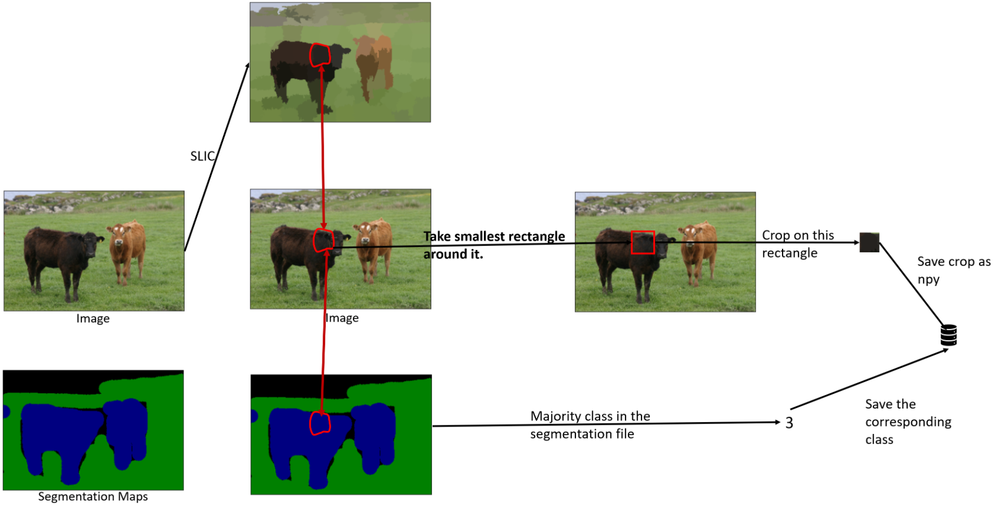


In addition to your code, **the primary graded deliverables** for this question are the 12 demo images we request after you have written code for the dataset.

In [ ]:
pip install tqdm

In [ ]:
import os
import cv2
import numpy as np
from tqdm import tqdm
from skimage.segmentation import slic
from scipy import ndimage
from scipy import stats
from scipy.stats import mode
import matplotlib.pyplot as plt
import pandas as pd
from scipy import ndimage as ndi
from skimage.measure import regionprops
from skimage.io import imsave

Original file

  

In [ ]:
import os
from sklearn.model_selection import train_test_split
import os
import cv2
import numpy as np
from skimage.segmentation import slic
from skimage.io import imsave
from tqdm import tqdm
import pandas as pd


In [ ]:
# run SLIC on each original images and save the (segment patch, ID label) pair
# segments = slic(image, n_segments=100, compactness=10)
# it may take up to half an hour to process, depending on the hardware resources
# save the output file names to train.txt
# Alternatively, you don't save the segment patch and ID label offline, instead,
# you process them on the fly later.

### STEPS
# 1. Data Preparation: Seperate/Sort image and ground truth segmentation files for further processing.
# 2. Perform superpixel segmentation on the images using the SLIC algorithm(segments = slic(image, n_segments=100, compactness=10))
# 3. Bounding Box Extraction: Extract bounding boxes for each superpixel in the segmented images
# 4. Label Assignment: Assign class labels to the extracted bounding boxes based on the majority class in the corresponding ground truth segmentation patch(mode)
# 5. Saving Extracted Patches: Save the extracted image patches and their corresponding labels as .npy files. The file paths and labels are also recorded in a CSV file for later use.
# 6. Data Splitting: Split the dataset into training and test sets using train_test_split from scikit-learn.
# 7. Create a CSV file  to store information about the saved patches and their labels as mentioned in the instructions.

current_directory = os.getcwd()
# print(current_directory)
msrc_directory = current_directory + '/MSRC_ObjCategImageDatabase_v1'

# Get lists of image files and corresponding ground truth files
image_files = sorted([os.path.join(msrc_directory, file) for file in os.listdir(msrc_directory) if file.endswith("s.bmp")])
ground_truth_files = sorted([os.path.join(msrc_directory, file) for file in os.listdir(msrc_directory) if file.endswith("GT.bmp")])

# Check if the number of image files matches the number of ground truth files
assert len(image_files) == len(ground_truth_files), f"Size mismatch Ground truth files: {len(ground_truth_files)} image files: {len(image_files)}"

# Split the data into training and testing sets
training_images, testing_images, training_gt_images, testing_gt_images = train_test_split(image_files, ground_truth_files, test_size=0.2, random_state=42)

# Print the sizes of the training and testing sets
print(f"Number of training images: {len(training_images)}")
print(f"Number of testing images: {len(testing_gt_images)}")

# Define a dictionary mapping RGB colors to class labels (rgb_2_label)
# This mapping should be based on your dataset's specific class labels and colors

def get_patches(image_files, ground_truth_files, rgb_2_label, mode='train'):
    # Get the root directory of the image files
    root, _ = os.path.split(image_files[0])
    # Create a folder for training or testing data if it doesn't exist
    if not os.path.isdir(root + f'/{mode}/'):
        print(root + "  was not present, creating the folder...")
        os.makedirs(root + f'/{mode}/')

    # Create a list to store information about the saved patches and labels
    metafile = []

    # Loop through each image and its corresponding ground truth
    for i in tqdm(range(len(image_files))):
       # Load the image and its ground truth segmentation
        image = cv2.imread(image_files[i])[:, :, ::-1]
        ground_truth  = cv2.imread(ground_truth_files[i])[:, :, ::-1]

        # Perform superpixel segmentation using SLIC
        seg_map = slic(image, n_segments=100, compactness=10) # as instructed in the question.

        nonecounter = 0

        # Loop through each superpixel in the segmentation map
        for seg_id in np.unique(seg_map):
            h, w = seg_map.shape
            seg_indices = np.where(seg_map == seg_id)
            n_dilate = 3

            if len(seg_indices[0]):
                y_min, y_max = min(seg_indices[0]), max(seg_indices[0])
                x_min, x_max = min(seg_indices[1]), max(seg_indices[1])

                # Dilate the rectangle boundaries
                x_min, x_max = max(0, x_min - n_dilate), min(w, x_max + n_dilate)
                y_min, y_max = max(0, y_min - n_dilate), min(h, y_max + n_dilate)
                (y1, x1), (y2, x2) = (y_min, x_min), (y_max, x_max)

                seg_patch = image[y1:y2, x1:x2, :]
                if seg_patch.shape[0] >= 5 and seg_patch.shape[1] >= 5:

                    gt_patch = ground_truth[y1:y2, x1:x2, :]
                    patch_label = -1
                    label_dict = {}
                    labels = np.unique(list(rgb_2_label.values()))

                    # Count the occurrences of class labels in the ground truth patch
                    for label in labels:
                        label_dict[label] = 0

                    h, w = gt_patch.shape[:2]

                    for y in range(h):
                        for x in range(w):
                            color = tuple(gt_patch[y, x])
                            label = rgb_2_label.get(color, -1)
                            label_dict[label] += 1

                    # Assign the class label with the highest count to the patch
                    patch_label  = max(label_dict, key=label_dict.get)

                    # Save the extracted patch and label as .npy files
                    _, image_name = os.path.split(image_files[i])
                    savefilename = root + f'/{mode}/' + image_name.replace('.bmp', f'_C{seg_id}_.npy')
                    np.save(savefilename, seg_patch)
                    metafile.append([savefilename, patch_label])

            else:
                nonecounter += 1

        if nonecounter:
             print(f"Warning: {nonecounter} out of {100} segments in {image_name} are empty.")

    # Create a CSV file to store information about saved patches and labels
    metadf = pd.DataFrame(metafile, columns=['path', 'label'])
    metadf.to_csv(f'{root}/{mode}meta.csv')
    #metadf.to_csv('/content/drive/MyDrive/CMSC828I_HW1/MSRC_ObjCategImageDatabase_v1/train/meta.csv')


Number of training images: 192
Number of testing images: 48


In [ ]:
# Example usage:
get_patches(training_images, training_gt_images, rgb_2_label, mode='train')

100%|██████████| 192/192 [05:22<00:00,  1.68s/it]


In [ ]:
get_patches(testing_images, testing_gt_images, rgb_2_label, mode='test')

100%|██████████| 48/48 [08:37<00:00, 10.79s/it]


In [ ]:
training_df = pd.read_csv(f'{msrc_directory}/train/trainmeta.csv')
print("train df value counts \n", training_df.label.value_counts())

train df value counts 
 -1    3289
 1    2649
 4    1481
 0    1143
 7     755
 2     632
 3     624
 6     327
 5     292
 8     242
Name: label, dtype: int64


In [ ]:
testing_df = pd.read_csv(f'{msrc_directory}/test/testmeta.csv')
print("test df value counts \n", testing_df.label.value_counts())

test df value counts 
 -1    982
 1    746
 4    316
 0    269
 6    158
 7    139
 2    133
 3    105
 5     85
 8     71
Name: label, dtype: int64


(22, 82, 3)


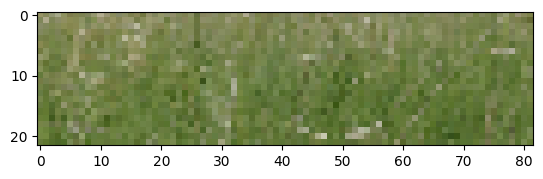

In [ ]:
import numpy as np

data = np.load('/content/drive/MyDrive/CMSC828I_HW1/MSRC_ObjCategImageDatabase_v1/train/1_6_s_C2_.npy')
import matplotlib.pyplot as plt
print(data.shape)
plt.imshow(data)
plt.show()

In [ ]:
import os
import numpy as np
import torch
import torch.utils.data as data
from PIL import Image
from torchvision import transforms
import _pickle as pickle
import torch.nn as nn
import torchvision.models as models
import torch.nn.functional as F

# -------------
# Dataset class
# -------------
#
# ``torch.utils.data.Dataset`` is an abstract class representing a
# dataset.
# Your custom dataset should inherit ``Dataset`` and override the following
# methods:
#
# -  ``__len__`` so that ``len(dataset)`` returns the size of the dataset.
# -  ``__getitem__`` to support the indexing such that ``dataset[i]`` can
#    be used to get sp_i sample
#
# Let's create a dataset class for our superpixel dataset. We will
# read the csv in ``__init__`` but leave the reading of images to
# ``__getitem__``. This is memory efficient because all the images are not
# stored in the memory at once but read as required.
#
# Sample of our dataset will be a dict
# ``{'superpixel image': image, 'superpixel class': class}``. Our dataset will take an
# optional argument ``transform`` so that any required processing can be
# applied on the sample. Remember to resize the image using ``transform``.

class SegmentationData(data.Dataset):

    def __init__(self,path,mode,transform=None):
        # Your code
      self.df = pd.read_csv(f'{path}/{mode}/{mode}meta.csv', skiprows=1, header=None)
      print(f"{mode}loader length{len(self.df)}")
      self.transform = transform
        # pass

    def __len__(self):
        # Your code
        return len(self.df)
        # pass

    def __getitem__(self, index):
      # Your code
      # load images and label
      image = np.load(self.df.iloc[index, 1], allow_pickle=True)
      label = int(self.df.iloc[index, 2])
      # apply transform
      if self.transform:
        image = self.transform(image)
      return image, label+1 # shift all labels by +1
          #pass

mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

custom_transforms = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),#As mentioned in the instructions to rescale the images
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(degrees=15),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
        ])

In [ ]:
# load the data
batch_size = 10
training_set = SegmentationData(path =msrc_directory,  mode = 'train', transform=custom_transforms)
val_set = SegmentationData(path =msrc_directory,  mode = 'test', transform=custom_transforms)

trainloader length11434
testloader length3004


Show some outputs! Choose 1 image. For that image, plot the image, along with the superpixel map for the image, as you did for Assignment 1. Then, show the first 10 superpixel patches for the image, retrieved from your dataset.

The output for this portion will be 12 images, displayed below your code below.

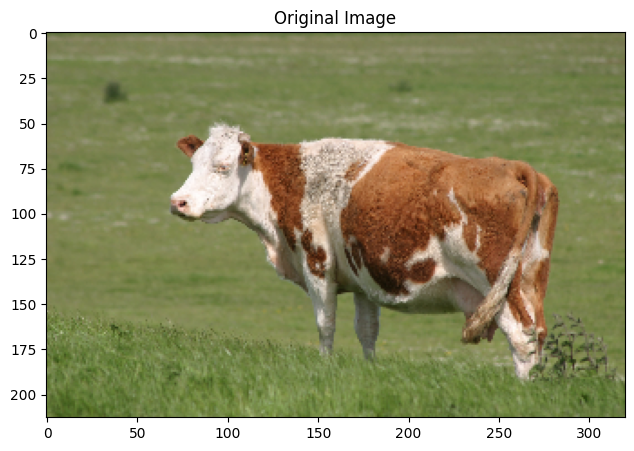

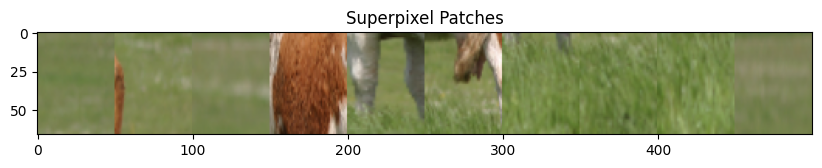

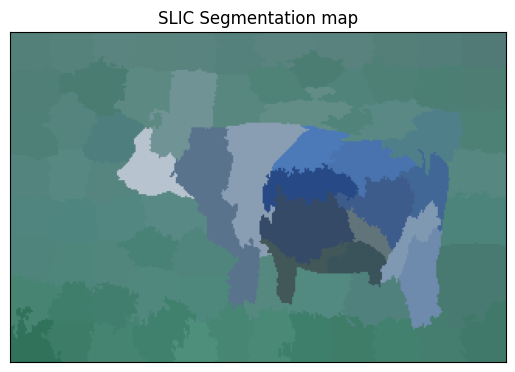

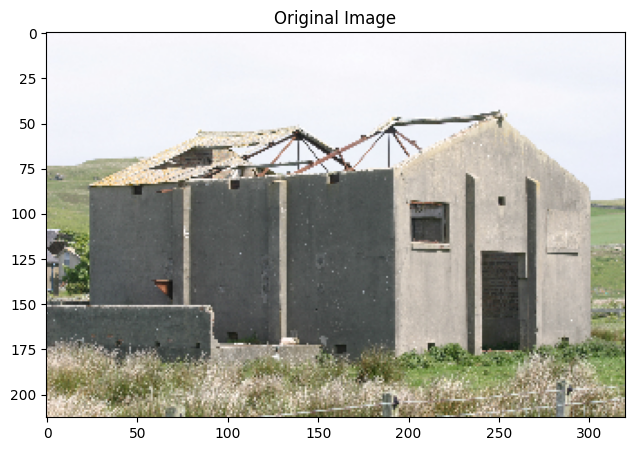

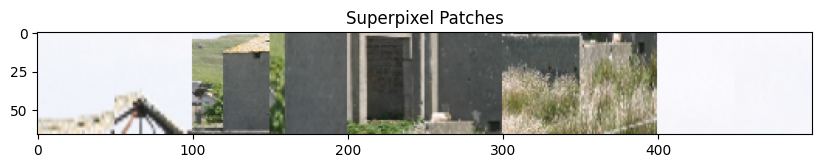

...

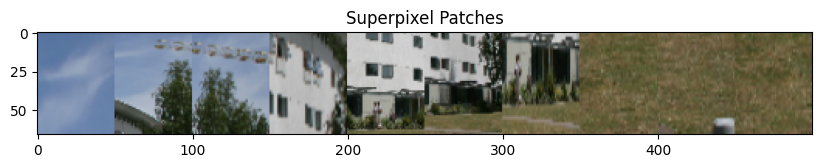

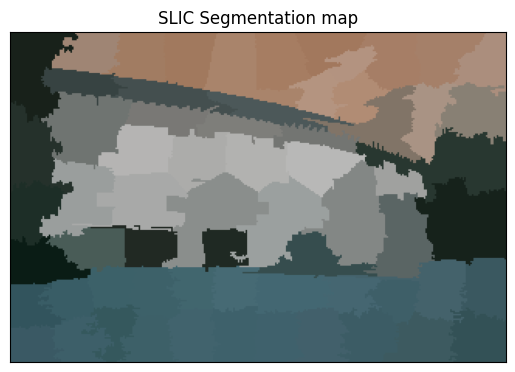

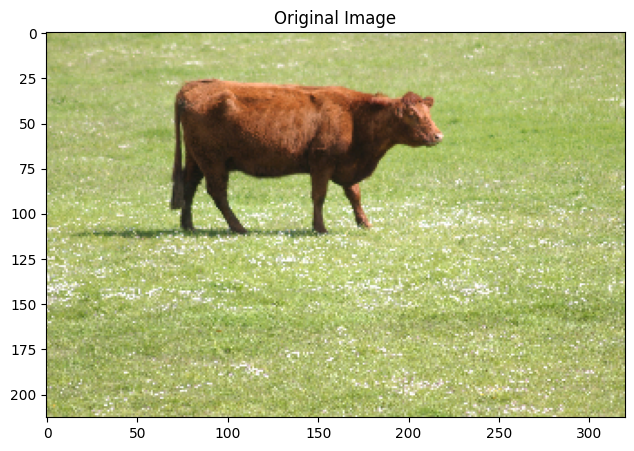

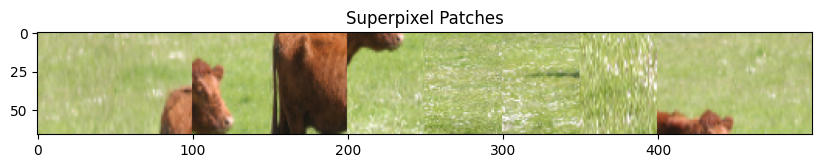

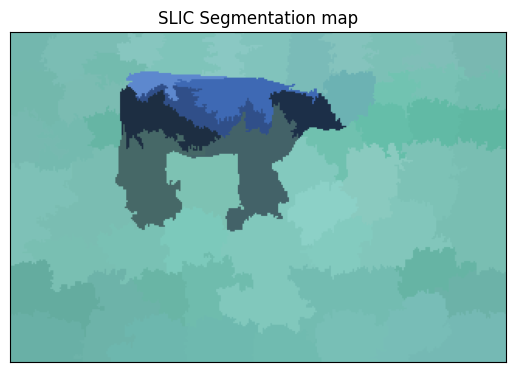

In [ ]:
### YOUR CODE TO PLOT 12 images (original RGB + superpixel map + first 10 superpixels) ###

import random
import glob

def get_patches(image_filepath, folder):

    _, prefix = os.path.split(image_filepath)
    patchname = folder+f'/{prefix[:-4]}'
    return glob.glob(patchname +'*.npy')


def generate_patch_grid_visualization(patches):

    # Limit to a maximum of 10 patches
    num_patches = min(len(patches), 10)
    patch_samples = sorted(random.sample(patches, num_patches))  # Sample the patches

    patch_list  = []
    horizontal_bar  = np.zeros((66, 5, 3), dtype=np.uint8)
    vertical_bar = np.zeros((5, 220, 3), dtype=np.uint8)

    for i in range(0, len(patch_samples)):
        patch = cv2.resize(np.load(patch_samples[i]), (50, 66))
        patch_list.append(patch)

    # Create a grid with the available patches
    allpatches = np.hstack(patch_list)

    # If there are not enough patches, add empty columns
    if num_patches < 10:
        empty_cols = np.zeros((66, (10 - num_patches) * (50 + 5), 3), dtype=np.uint8)
        allpatches = np.hstack((allpatches, empty_cols))

    return allpatches


trainfolder = msrc_directory + f'/train'
testfolder = msrc_directory + f'/test'

for i in range(12):

    file = training_images[i]
    image = cv2.imread(file)[:,:,::-1]
    patches = get_patches( file, trainfolder)
    grid =  generate_patch_grid_visualization(patches)
    seg_map = slic(image, n_segments=100, compactness=10)

    # Display the original image
    plt.figure(figsize=(10, 5))
    plt.imshow(image)
    plt.title('Original Image')
    plt.show()

    # Display the superpixel patches
    plt.figure(figsize=(10, 5))
    plt.imshow(grid)
    plt.title('Superpixel Patches')
    plt.show()
    seg_map = superpixel_plot(image, seg_map,title = f"SLIC Segmentation map")

    plt.show()


### Question 6: Deep Network (10 points)

You could use a pre-trained network (like VGG) and replace the last few layers with a fully connected layer.

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

In [ ]:
is_cuda_available = torch.cuda.is_available()
if is_cuda_available:
    print("CUDA IS BEING USED")
device = torch.device("cuda:0" if is_cuda_available else "cpu")
print(device)
def to_device(args):
  return [arg.to(device) for arg in args]

# Model definition
class SegmentationNN(nn.Module):
    def __init__(self, no_of_classes=10):
        super(SegmentationNN, self).__init__()

        # Load the pre-trained ResNet model
        resnet50 = self.resnet50_backbone().to(device)

        # Replace the final classification layer for segmentation
        in_channels = resnet50.fc.in_features
        resnet50.fc = nn.Sequential(
            nn.Linear(in_channels, 512),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(512, no_of_classes)
        )
        self.model = resnet50

    def resnet50_backbone(self, freeze=True):
        # Load pre-trained ResNet-50
        resnet50 = models.resnet50(pretrained=True)

        # Freeze weights
        if freeze:
          for param in resnet50.parameters():
              param.requires_grad = False
        return resnet50

    def forward(self, x):
        # Forward Pass
        x = self.model(x)
        return x



CUDA IS BEING USED
cuda:0


### Question 7: Optimizer (10 points)

Finally, we define the classification loss and optimizer such that we can learn a superpixel classifier from the backproporgation algorithm.

In [ ]:
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
import time
import torch.nn as nn


In [ ]:

# Optimizer
class Solver(object):
    def __init__(self, model, num_epochs=5, learning_rate=5e-4):
        self.model = model
        self.num_epochs = num_epochs
        self.loss_fn = nn.CrossEntropyLoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=learning_rate)
        self.scheduler = ReduceLROnPlateau(self.optimizer, factor=0.2, patience=6, verbose=True)
        self.iterations = 0
        self.train_losses = []  # List to store training losses
        self.train_accuracies = []  # List to store training accuracies
        self.test_losses = []  # List to store validation losses
        self.test_accuracies = []  # List to store validation accuracies

    def train(self, train_loader, val_loader=None):
        # Your code

        for epoch in range(self.num_epochs):
            self.model.train()
            start_time = time.time()
            losses = []
            accuracies = []

            for i, instance in tqdm(enumerate(train_loader)):
                image, label = to_device(instance)
                predvec = self.model(image)

                # Calculate the loss
                loss = self.loss_fn(predvec, label)
                losses.append(loss.item())

                # Gradient descent
                self.optimizer.zero_grad()
                loss.backward()
                self.optimizer.step()

                # Calculate the accuracy
                _, preds = torch.max(predvec, 1)
                acc = torch.sum(preds == label) / label.size(0)
                accuracies.append(acc.item())
                self.iterations += 1

            # Process end of epoch
            end_time = time.time() - start_time
            avg_loss = sum(losses) / len(losses)
            avg_accuracy = sum(accuracies) / len(accuracies)
            self.scheduler.step(avg_loss)
            print(f"Epoch: {epoch}/{self.num_epochs} ({self.iterations:.2f} iters) took {end_time/60:.2f} mins || Acc: {avg_accuracy:.2f} || Loss: {avg_loss:.2f}")

            # Append training results to lists
            self.train_losses.append(avg_loss)
            self.train_accuracies.append(avg_accuracy)

            if val_loader:
                test_loss, test_acc = self.evaluate(val_loader)
                # print(f"Validation Loss: {test_loss:.2f}, Validation Accuracy: {test_acc:.2f}")

        print("-----------Training Done-----------")
        return self.train_losses, self.train_accuracies

    def evaluate(self, val_loader):
      # Set the model in evaluation mode
      self.model.eval()
      start_time = time.time()
      losses = []
      accuracies = []
      true = 0
      num_samples = 0

      # Disable gradient computation for evaluation
      with torch.no_grad(): #inference manager
          for i, instance in tqdm(enumerate(val_loader)):
              image, label = to_device(instance)
              predvec = self.model(image)

              # Calculate the loss
              loss = self.loss_fn(predvec, label)
              losses.append(loss.item())

              # Calculate the accuracy
              _, preds = torch.max(predvec, 1)
              true += torch.sum(preds == label)
              num_samples += label.size(0)

              # Calculate accuracy for the current batch
              accuracy = true / num_samples
              accuracies.append(accuracy.item())

      # Calculate elapsed time for evaluation
      end_time = time.time() - start_time

      # Calculate the average accuracy and loss over all batches
      avg_accuracy = sum(accuracies) / len(accuracies)
      avg_loss = sum(losses) / len(losses)
      self.test_losses.append(avg_loss)
      self.test_accuracies.append(avg_accuracy)

      # Print the evaluation results
      print(f"Validation: took {end_time/60:.2f} mins || Acc: {avg_accuracy:.2f} || Loss: {avg_loss:.2f}")

      return self.test_losses, self.test_accuracies

### Question 8: Putting it together (50 points)

Train your network and observe the loss in time.
During the inference stage, combine the SLIC Superpixels' predicted labels to form the whole input image's superpixel segmentation results.
The following 4 items are the primary graded components:

1. You must randomly split the whole dataset into train and test subset (80:20 split is fine).
2. You must show the training loss of the classifier after every epoch
3. You must show the training accuracy and test accuracy of the classifier after training.
4. You must plot as least one visualization showing the test segmentation map vs. ground truth segmentation map.

In [ ]:
def plot_curves(losses, accuracies, mode='Training'):
    # Plotting loss curve
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(losses, label=f'{mode} Loss')
    plt.title(f'{mode} Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    # Plotting accuracy curve
    plt.subplot(1, 2, 2)
    plt.plot(accuracies, label=f'{mode} Accuracy')
    plt.title(f'{mode} Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # Display the plots
    plt.tight_layout()
    plt.show()

trainloader length11434
testloader length3004
 Samples in train_loader: 358
 Samples in val_loader: 94


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
358it [00:20, 17.84it/s]

Epoch: 0/10 (358.00 iters) took 0.34 mins || Acc: 0.63 || Loss: 1.13



94it [00:05, 17.61it/s]

Validation: took 0.09 mins || Acc: 0.76 || Loss: 0.69



358it [00:20, 17.67it/s]

Epoch: 1/10 (716.00 iters) took 0.34 mins || Acc: 0.76 || Loss: 0.69



94it [00:05, 17.47it/s]

Validation: took 0.09 mins || Acc: 0.80 || Loss: 0.56



358it [00:21, 16.91it/s]

Epoch: 2/10 (1074.00 iters) took 0.35 mins || Acc: 0.78 || Loss: 0.61



94it [00:05, 17.23it/s]

Validation: took 0.09 mins || Acc: 0.81 || Loss: 0.54



358it [00:21, 16.97it/s]

Epoch: 3/10 (1432.00 iters) took 0.35 mins || Acc: 0.80 || Loss: 0.57



94it [00:05, 17.28it/s]

Validation: took 0.09 mins || Acc: 0.83 || Loss: 0.49



358it [00:20, 17.16it/s]

Epoch: 4/10 (1790.00 iters) took 0.35 mins || Acc: 0.81 || Loss: 0.54



94it [00:05, 16.95it/s]


Validation: took 0.09 mins || Acc: 0.84 || Loss: 0.48


358it [00:21, 16.54it/s]

Epoch: 5/10 (2148.00 iters) took 0.36 mins || Acc: 0.81 || Loss: 0.52



94it [00:05, 16.46it/s]


Validation: took 0.10 mins || Acc: 0.83 || Loss: 0.48


358it [00:20, 17.36it/s]

Epoch: 6/10 (2506.00 iters) took 0.35 mins || Acc: 0.82 || Loss: 0.49



94it [00:05, 17.18it/s]

Validation: took 0.09 mins || Acc: 0.84 || Loss: 0.45



358it [00:21, 16.71it/s]

Epoch: 7/10 (2864.00 iters) took 0.36 mins || Acc: 0.83 || Loss: 0.48



94it [00:05, 17.30it/s]

Validation: took 0.09 mins || Acc: 0.83 || Loss: 0.46



358it [00:20, 17.43it/s]

Epoch: 8/10 (3222.00 iters) took 0.34 mins || Acc: 0.82 || Loss: 0.47



94it [00:05, 16.78it/s]

Validation: took 0.09 mins || Acc: 0.84 || Loss: 0.45



358it [00:20, 17.76it/s]

Epoch: 9/10 (3580.00 iters) took 0.34 mins || Acc: 0.83 || Loss: 0.45



94it [00:05, 16.92it/s]


Validation: took 0.09 mins || Acc: 0.83 || Loss: 0.46
-----------Training Done-----------


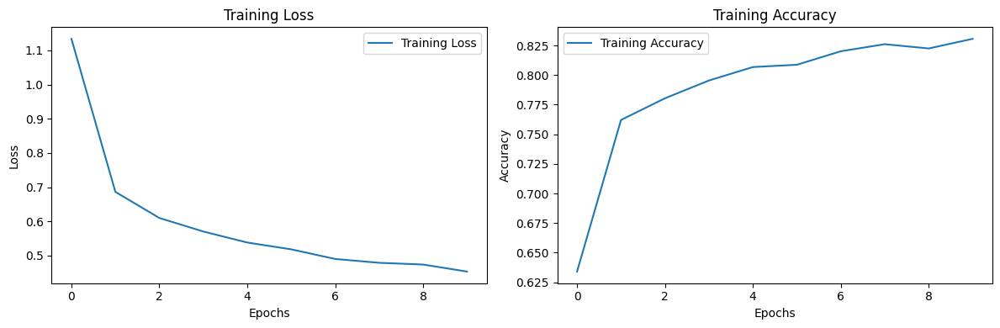

94it [00:05, 17.58it/s]


Validation: took 0.09 mins || Acc: 0.84 || Loss: 0.46


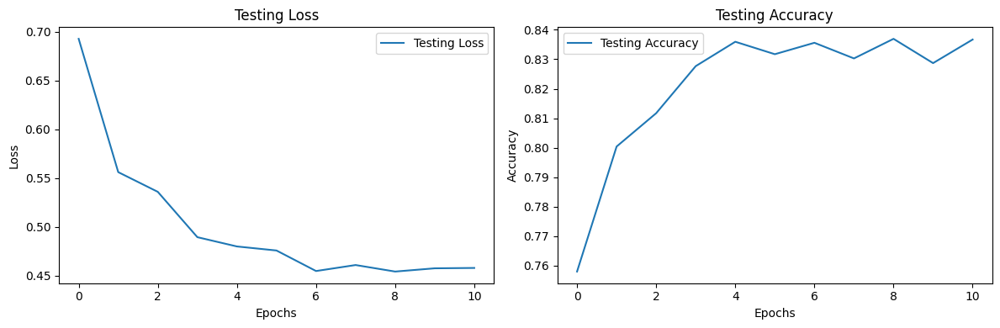

In [ ]:
from torch.utils.data import DataLoader, random_split

# load the data
# Define your custom SegmentationData dataset class (as defined in Question 6)

# Define the SegmentationNN model class (as defined in Question 6)

# Define the Solver class (as defined in Question 7)

torch.manual_seed(42)

# Using Mean and std values of Imagenet, Resnet (Default used in pytorch)link:- https://pytorch.org/hub/pytorch_vision_resnet/
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

custom_transforms = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),#As mentioned in the instructions to rescale the images
        # transforms.RandomHorizontalFlip(),
        # transforms.RandomRotation(degrees=15),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
        ])
batch_size = 32

# load the data
training_set = SegmentationData(path =msrc_directory,  mode = 'train', transform=custom_transforms)
val_set = SegmentationData(path =msrc_directory,  mode = 'test', transform=custom_transforms)

# data loader
train_loader = data.DataLoader(dataset=training_set, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = data.DataLoader(dataset=val_set, batch_size=batch_size, shuffle=True, num_workers=2)

# Print the sizes of the training and testing sets
print(f" No of samples in training_loader: {len(train_loader)}")
print(f" No of samples in validation_loader: {len(val_loader)}")

# model
model = SegmentationNN().to(device)
solver = Solver(model, learning_rate=1e-4, num_epochs=10)

# train the model
train_losses, train_accuracies = solver.train(train_loader, val_loader)
plot_curves(train_losses, train_accuracies, mode='Training')
torch.save(model.state_dict(), 'SegmentationNNv2.pth')

# Evaluate the model
test_losses, test_accuracies = solver.evaluate(val_loader)
plot_curves(test_losses, test_accuracies, mode='Testing')



94it [00:06, 15.28it/s]


Validation: took 0.10 mins || Acc: 0.84 || Loss: 0.44


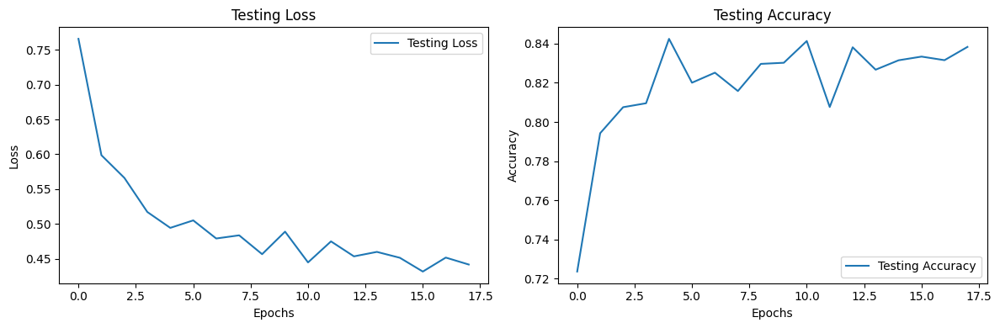

In [ ]:
model.load_state_dict(torch.load('SegmentationNNv2.pth'))
# Evaluate the model
test_losses, test_accuracies = solver.evaluate(val_loader)
plot_curves(test_losses, test_accuracies, mode='Testing')

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
358it [00:22, 15.65it/s]

Epoch: 0/10 (358.00 iters) took 0.38 mins || Acc: 0.60 || Loss: 1.22



94it [00:06, 15.39it/s]

Validation: took 0.10 mins || Acc: 0.76 || Loss: 0.75



358it [00:22, 15.57it/s]

Epoch: 1/10 (716.00 iters) took 0.38 mins || Acc: 0.74 || Loss: 0.76



94it [00:06, 15.18it/s]

Validation: took 0.10 mins || Acc: 0.80 || Loss: 0.61



358it [00:23, 15.19it/s]

Epoch: 2/10 (1074.00 iters) took 0.39 mins || Acc: 0.76 || Loss: 0.67



94it [00:06, 14.65it/s]

Validation: took 0.11 mins || Acc: 0.82 || Loss: 0.53



358it [00:22, 15.77it/s]

Epoch: 3/10 (1432.00 iters) took 0.38 mins || Acc: 0.78 || Loss: 0.61



94it [00:06, 15.45it/s]


Validation: took 0.10 mins || Acc: 0.81 || Loss: 0.52


358it [00:23, 15.48it/s]

Epoch: 4/10 (1790.00 iters) took 0.39 mins || Acc: 0.78 || Loss: 0.58



94it [00:05, 15.74it/s]

Validation: took 0.10 mins || Acc: 0.83 || Loss: 0.49



358it [00:22, 15.88it/s]

Epoch: 5/10 (2148.00 iters) took 0.38 mins || Acc: 0.80 || Loss: 0.56



94it [00:06, 15.46it/s]

Validation: took 0.10 mins || Acc: 0.82 || Loss: 0.49



358it [00:22, 15.65it/s]

Epoch: 6/10 (2506.00 iters) took 0.38 mins || Acc: 0.80 || Loss: 0.55



94it [00:06, 15.34it/s]


Validation: took 0.10 mins || Acc: 0.83 || Loss: 0.49


358it [00:22, 15.77it/s]


Epoch: 7/10 (2864.00 iters) took 0.38 mins || Acc: 0.79 || Loss: 0.55


94it [00:05, 16.01it/s]


Validation: took 0.10 mins || Acc: 0.83 || Loss: 0.48


358it [00:22, 15.60it/s]

Epoch: 8/10 (3222.00 iters) took 0.38 mins || Acc: 0.81 || Loss: 0.52



94it [00:05, 15.83it/s]

Validation: took 0.10 mins || Acc: 0.82 || Loss: 0.46



358it [00:22, 15.68it/s]

Epoch: 9/10 (3580.00 iters) took 0.38 mins || Acc: 0.81 || Loss: 0.51



94it [00:06, 15.61it/s]


Validation: took 0.10 mins || Acc: 0.84 || Loss: 0.47
-----------Training Done-----------


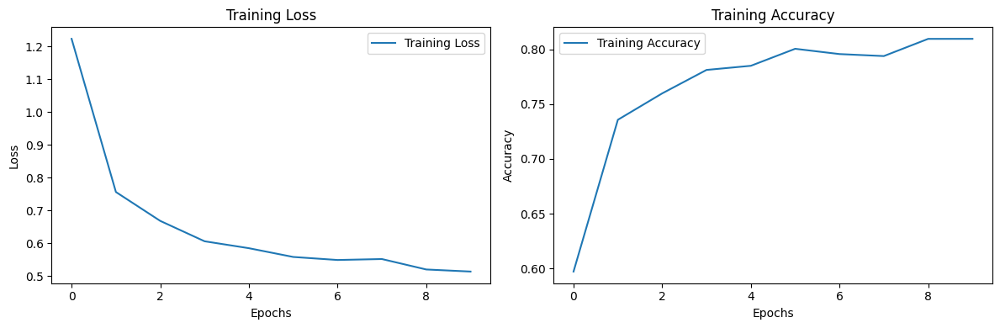

94it [00:05, 15.93it/s]


Validation: took 0.10 mins || Acc: 0.81 || Loss: 0.46


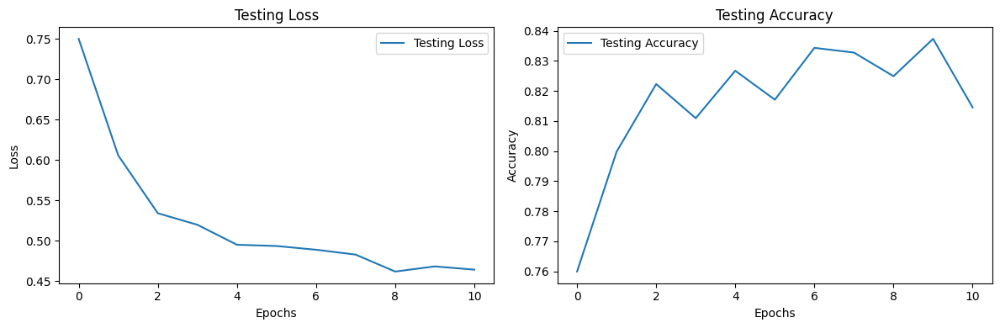

In [ ]:
# model
model2 = SegmentationNN().to(device)
solver = Solver(model2, learning_rate=1e-4, num_epochs=10)

# train the model
train_losses, train_accuracies = solver.train(train_loader, val_loader)
plot_curves(train_losses, train_accuracies, mode='Training')
torch.save(model.state_dict(), 'SegmentationNNv3.pth')

# Evaluate the model
test_losses, test_accuracies = solver.evaluate(val_loader)
plot_curves(test_losses, test_accuracies, mode='Testing')

In [ ]:
model.load_state_dict(torch.load('SegmentationNNv3.pth'))
solver.evaluate(val_loader)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
358it [00:22, 15.92it/s]

Epoch: 0/10 (358.00 iters) took 0.38 mins || Acc: 0.57 || Loss: 1.30



94it [00:05, 16.31it/s]

Validation: took 0.10 mins || Acc: 0.77 || Loss: 0.82



358it [00:22, 16.11it/s]

Epoch: 1/10 (716.00 iters) took 0.37 mins || Acc: 0.72 || Loss: 0.81



94it [00:06, 15.40it/s]

Validation: took 0.10 mins || Acc: 0.80 || Loss: 0.65



358it [00:24, 14.91it/s]

Epoch: 2/10 (1074.00 iters) took 0.40 mins || Acc: 0.76 || Loss: 0.69



94it [00:05, 15.69it/s]


Validation: took 0.10 mins || Acc: 0.81 || Loss: 0.57


358it [00:21, 16.27it/s]


Epoch: 3/10 (1432.00 iters) took 0.37 mins || Acc: 0.77 || Loss: 0.64


94it [00:05, 15.94it/s]

Validation: took 0.10 mins || Acc: 0.81 || Loss: 0.54



358it [00:22, 15.61it/s]

Epoch: 4/10 (1790.00 iters) took 0.38 mins || Acc: 0.78 || Loss: 0.61



94it [00:05, 16.11it/s]

Validation: took 0.10 mins || Acc: 0.83 || Loss: 0.53



358it [00:22, 15.81it/s]

Epoch: 5/10 (2148.00 iters) took 0.38 mins || Acc: 0.78 || Loss: 0.59



94it [00:06, 14.89it/s]

Validation: took 0.11 mins || Acc: 0.81 || Loss: 0.52



358it [00:22, 16.04it/s]

Epoch: 6/10 (2506.00 iters) took 0.37 mins || Acc: 0.79 || Loss: 0.57



94it [00:06, 15.07it/s]


Validation: took 0.11 mins || Acc: 0.82 || Loss: 0.51


358it [00:22, 15.60it/s]

Epoch: 7/10 (2864.00 iters) took 0.38 mins || Acc: 0.80 || Loss: 0.56



94it [00:05, 16.03it/s]


Validation: took 0.10 mins || Acc: 0.82 || Loss: 0.51


358it [00:23, 15.55it/s]

Epoch: 8/10 (3222.00 iters) took 0.39 mins || Acc: 0.80 || Loss: 0.55



94it [00:06, 15.59it/s]


Validation: took 0.10 mins || Acc: 0.83 || Loss: 0.50


358it [00:23, 15.17it/s]

Epoch: 9/10 (3580.00 iters) took 0.39 mins || Acc: 0.81 || Loss: 0.52



94it [00:06, 15.26it/s]


Validation: took 0.10 mins || Acc: 0.82 || Loss: 0.47
-----------Training Done-----------


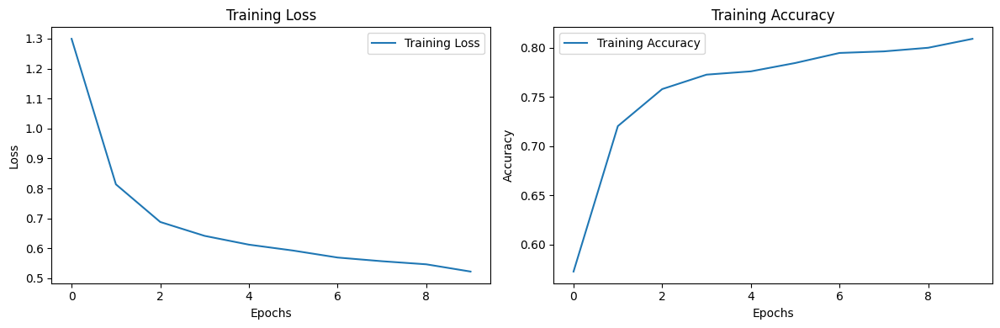

94it [00:05, 16.29it/s]


Validation: took 0.10 mins || Acc: 0.83 || Loss: 0.48


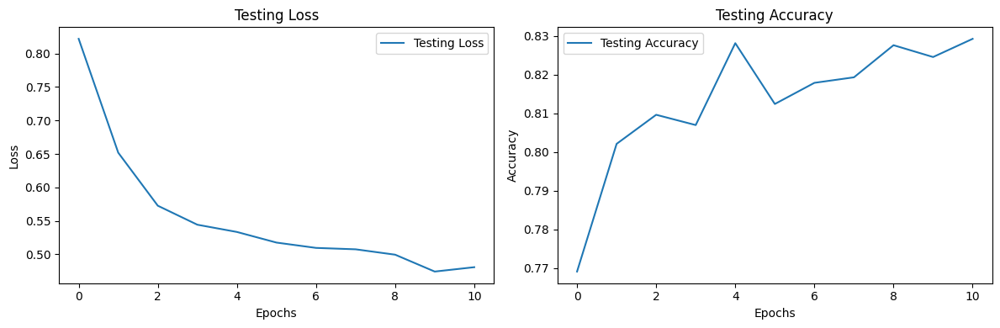

In [ ]:
# model
model3 = SegmentationNN().to(device)
solver = Solver(model3, learning_rate=7e-5, num_epochs=10)

# train the model
train_losses, train_accuracies = solver.train(train_loader, val_loader)
plot_curves(train_losses, train_accuracies, mode='Training')
torch.save(model.state_dict(), 'SegmentationNNv5.pth')

# Evaluate the model
test_losses, test_accuracies = solver.evaluate(val_loader)
plot_curves(test_losses, test_accuracies, mode='Testing')

94it [00:06, 15.14it/s]


Validation: took 0.10 mins || Acc: 0.84 || Loss: 0.48


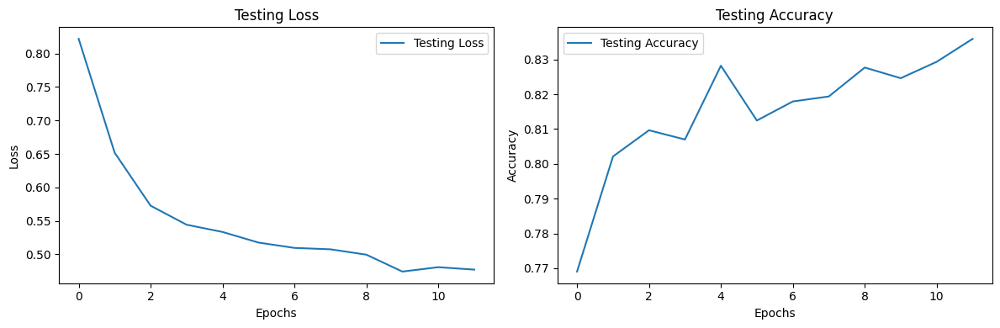

In [ ]:
model.load_state_dict(torch.load('SegmentationNNv3.pth'))
test_losses, test_accuracies = solver.evaluate(val_loader)
plot_curves(test_losses, test_accuracies, mode='Testing')

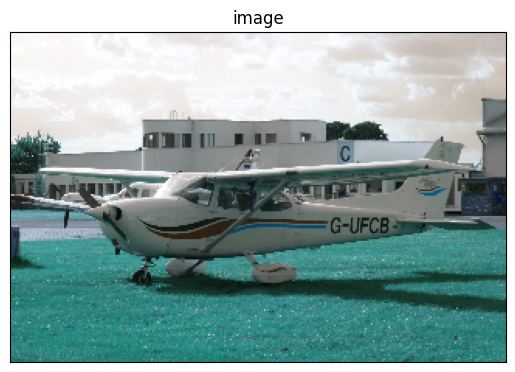

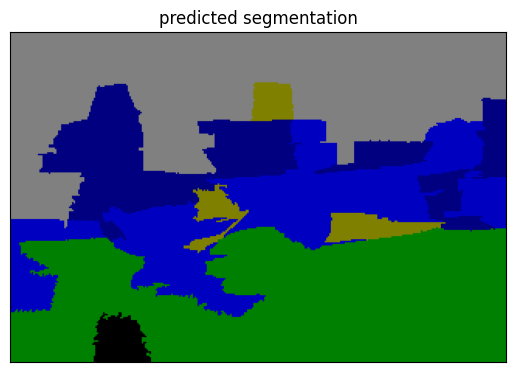

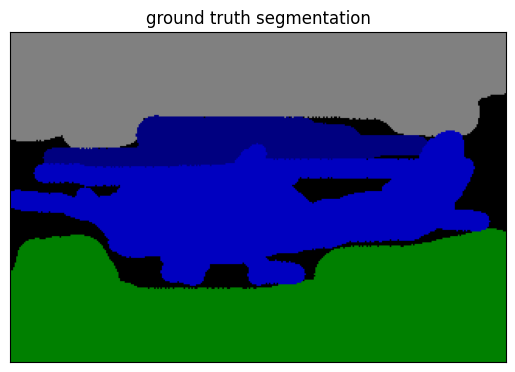

In [ ]:

def get_patches(image, groundtruth, segmap, rgb_2_label, transforms=None, n_segments=100, n_classes=10):
    """
    Computes patches and groundtruth and labels for a given image.

    """
    # Iterate through unique segment ids found in segmap.
    for seg_id in list(np.unique(segmap)):

        # obtain dimensions of the segmentation map and store seg ids which are equal to current id.
        h, w = segmap.shape
        seg_indices = np.where(segmap == seg_id)
        n_dilate = 3

        # calculate maximum and minimum of the usper pixels and dilate them
        if len(seg_indices[0]):
            # find boundaries of patch to make a rectangle
            y_min, y_max = min(seg_indices[0]), max(seg_indices[0])
            x_min, x_max = min(seg_indices[1]), max(seg_indices[1])
            # dilate rectangle
            x_min, x_max = max(0, x_min - n_dilate), min(w, x_max + n_dilate)
            y_min, y_max = max(0, y_min - n_dilate), min(h, y_max + n_dilate)
            bounding_box = (y_min, x_min), (y_max, x_max)
        else:
            # If no segments found with seg_id, continue to the next segment
            continue

        if ((bounding_box[1][0] - bounding_box[0][0]) < 2 or (bounding_box[1][1] - bounding_box[0][1]) < 2):
            # If the bounding box size is too small, skip it
            continue
        (y1, x1), (y2, x2) = bounding_box

        #extract seg patch
        seg_patch = image[y1:y2, x1:x2, :]

        if seg_patch.shape[0] < 2 or seg_patch.shape[1] < 2:
            # If the patch size is too small, skip it
            continue

        # seg groundtruth patch containing slic-segment seg_id
        gt_patch = groundtruth[y1:y2, x1:x2, :]

        # count the occurrences of class labels within the patch. Also extract the unique labels from the rgb_2_label mapping
        label_dict = {}
        labels = np.unique(list(rgb_2_label.values()))
        for label in labels:
            label_dict[label] = 0

        # Iterate through the pixels in the ground truth patch. For each pixel,convert the color to a label using the rgb_2_label mapping
        h, w = gt_patch.shape[:2]
        for y in range(h):
            for x in range(w):
                color = tuple(gt_patch[y, x])
                label = rgb_2_label.get(color, -1)
                label_dict[label] += 1

        #determine the class label for the patch by selecting the label with the highest count
        gt_patch_label = max(label_dict, key=label_dict.get)

        if transforms:
            yield transforms(seg_patch).unsqueeze(0), torch.tensor(gt_patch_label)
        else:
            yield seg_patch, gt_patch, gt_patch_label

import random

# Generate a random number
x = random.randint(1, 30)

# read random image, get ground truth, get seg map
image = cv2.imread(testing_images[x])[:, :, ::-1]
groundtruth = cv2.imread(testing_gt_images[x])[:, :, ::-1]
segmap = slic(image, n_segments=100, compactness=10)

superpix2segDict = {}
pred_segment = np.zeros(image.shape, dtype=np.uint8)

for i, sample in enumerate(get_patches(image, groundtruth, segmap, rgb_2_label, transforms=custom_transforms, n_segments=100)):
    patch, label = to_device(sample)
    predvec = model(patch)
    _, preds = torch.max(predvec, 1)

    superpix2segDict[i] = preds.item() - 1
    indices = (segmap == i)
    pred_segment[indices] = label_2_rgb[preds.item() - 1]  #

plot_image(image, 'image')
plot_image(pred_segment, 'predicted segmentation')
plot_image(groundtruth, 'ground truth segmentation')

### Question 9: Bonus Question (20 points, OPTIONAL):

IMPORTANT: No matter which option you choose, you can earn a maximum of 20 points for this section.

We always want to increase the classifier accuracy and achieve a better performance by building a complicated deep learning model. There are a lot of tricks which are very popular and work in practice. Try to implement either of following two,

1. Could you effictively fuse different deep features from multiple layers in your network? You are welcome to use the pretrained network. Does your network achieve a better accuracy? There are a lot of exploration in the literature, including ION (Inside-Outside Net) [1], Hypercolumns [2], and PixelNet [3]. The following figure illustrates ION architecture combining features from different layers. Can you do similar thing for our Superpixel classifier?

2. Could you build a Multi-resolution network to explore the effectiveness of the multi-scale on the task of Superpixels segmentation? By multi-scale, we mean multiple resolutions of superpixels. See [4] for an example.

[1] Inside-Outside Net: Detecting Objects in Context with Skip Pooling and Recurrent Neural Networks

[2] Hypercolumns for Object Segmentation and Fine-grained Localization

[3] PixelNet: Representationofthe pixels, by the pixels, and for the pixels

[4] Feedforward semantic segmentation with zoom-out features

In [ ]:
# Bonus


In [ ]:
!jupyter nbconvert --to pdf '/content/drive/MyDrive/CMSC828I_HW1/rjadhav1(119256534)cmsc828I_fall2023_HW1.ipynb'


[NbConvertApp] Converting notebook /content/drive/MyDrive/CMSC828I_HW1/rjadhav1(119256534)cmsc828I_fall2023_HW1.ipynb to pdf
[NbConvertApp] Support files will be in rjadhav1(119256534)cmsc828I_fall2023_HW1_files/
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc828I_fall2023_HW1_files
[NbConvertApp] Making directory ./rjadhav1(119256534)cmsc8